In [24]:
# Standard library imports
import os
import sys
import time
import gzip
import glob
import pickle
from tqdm import tqdm

# Third-party library imports
import numpy as np
import pandas as pd
import matplotlib as mpl
import matplotlib.pyplot as plt
import matplotlib.cm as cm
import matplotlib.colors as mcolors
import matplotlib.font_manager as font_manager
import matplotlib.patches as mpatches
from mpl_toolkits.axes_grid1 import make_axes_locatable
import seaborn as sns
import umap
import PyPDF2
from natsort import natsorted
import random
import math

from scipy.cluster.hierarchy import dendrogram, linkage
from scipy.cluster import hierarchy
from scipy.spatial import distance
from scipy.stats import pearsonr
import scipy.stats
from sklearn.cluster import KMeans, MiniBatchKMeans, DBSCAN
from sklearn.preprocessing import StandardScaler
from sklearn.metrics import silhouette_score, mutual_info_score
from sklearn.metrics import precision_score, recall_score, f1_score
from sklearn.decomposition import PCA
from sklearn.decomposition import NMF

# Local application/library specific imports
sys.path.append('/net/seq/data2/projects/aabisheva/Encode/my_ipynb/Vocabulary')
import OONMF
import OONMFhelpers
from OONMFhelpers import get_barsortorder

In [25]:
import matplotlib.font_manager as fm
font_path = '/net/seq/data2/projects/aabisheva/Encode/my_ipynb/ARIAL.TTF'
if os.path.isfile(font_path):
    arial_font = fm.FontProperties(fname=font_path)
else:
    print(f"Font file not found: {font_path}")

In [26]:
# Set directory and styles
os.chdir("/net/seq/data2/projects/aabisheva/Encode/my_ipynb/")
plt.style.use('seaborn-v0_8-whitegrid')
sns.set_style("white")
cmap = cm.get_cmap('tab10')

/tmp/ipykernel_52826/3259779216.py:5: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  cmap = cm.get_cmap('tab10')


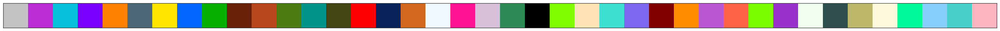

In [27]:
# Just color scheme inicialization

n_components = 40

colors_order = ['#FFE500', '#FE8102', '#FF0000', '#07AF00', '#4C7D14', '#414613', '#05C1D9', '#0467FD', '#009588', '#BB2DD4', '#7A00FF', '#4A6876', '#08245B', '#B9461D', '#692108', '#C3C3C3']
neworder = np.array([16,10,7,11,2,12,1,8,4,15,14,5,9,6,3,13]).astype(int) - 1
colors_order = list(np.array(colors_order)[neworder])

# THEN HERE IS A LOT WEIRD CODE TO SELECT COLORS
# Get colors for those indices from the existing random selection
colornames = np.sort(list(mcolors.CSS4_COLORS.keys()))
np.random.seed(10)
for _ in range(23):  
    newcolor = colornames[np.random.randint(len(colornames))]
    trialcount = 0
    while ((newcolor in colors_order) and (trialcount < 100)):
        newcolor = colornames[np.random.randint(0, len(colornames))]
        trialcount += 1
    colors_order.append(newcolor)

# Keep the colors you want
additional_indices = [19, 25, 26, 30, 39]
modified_colors = colors_order[:16]
for idx in additional_indices:
    modified_colors.append(colors_order[idx - 1])
modified_colors.extend(["black", "chartreuse", "moccasin"])

# Add random colors until the list has 40 colors
num_colors_to_add = n_components - len(modified_colors)
for _ in range(num_colors_to_add):
    newcolor = colornames[np.random.randint(len(colornames))]
    trialcount = 0
    while ((newcolor in modified_colors) and (trialcount < 100)):
        newcolor = colornames[np.random.randint(0, len(colornames))]
        trialcount += 1
    modified_colors.append(newcolor)
    
colors_order = modified_colors

# just for checking colors
fig, ax = plt.subplots(figsize=(len(modified_colors), 1))
# Draw a rectangle for each color in the list
for i, color in enumerate(modified_colors):
    rect = plt.Rectangle((i, 0), 1, 1, facecolor=color, edgecolor='none')
    ax.add_patch(rect)
ax.set_xlim(0, len(modified_colors))
ax.set_ylim(0, 1)
ax.set_xticks([])
ax.set_yticks([])
ax.set_aspect('equal')

plt.show()

In [28]:
def define_colors(self, reordercolors=False):
    maxassigned = 40
    self.Comp_colors = ['#C3C3C3', '#BB2DD4', '#05C1D9', '#7A00FF', '#FE8102', '#4A6876', '#FFE500', '#0467FD', '#07AF00', '#692108', '#B9461D', '#4C7D14', '#009588', '#414613', '#FF0000', '#08245B', 'chocolate', 'aliceblue', 'deeppink', 'thistle', 'seagreen', 'black', 'chartreuse', 'moccasin']

    if (self.Ncomps>maxassigned):
        # somewhat defunct but whatever. Adds extra "random" colors if you use more than 16 
        from matplotlib import colors as mcolors
        colornames = np.sort(list(mcolors.CSS4_COLORS.keys()))
        count = maxassigned
        np.random.seed(10)
        myrandint = np.random.randint(len(colornames))
        while (count < self.Ncomps):
            myrandint =    np.random.randint(len(colornames))
            newcolor = colornames[myrandint]
            trialcount = 0
            while ((newcolor in self.Comp_colors) and (trialcount < 100)):
                print('what am i doing here')
                newcolor = colornames[np.random.randint(0,len(colornames))]
                trialcount+=1
            print('new color ',count,newcolor)
            self.Comp_colors.append(newcolor)
            count+=1    
                
OONMF.NMFobject.define_colors = define_colors

In [29]:
def make_continuous_stacked_bar_plot_sorted(self, Nrelevant, BarMatrix, bargraph_out, names=[], barsortorder=[], plot_title='', figdim1=150, figdim2=40):
    if len(barsortorder) < 1:
        barsortorder = np.arange(Nrelevant)

    if len(names) < 1:
        names = [str(i) for i in range(Nrelevant)]
        names = np.array(names)

    start = 0
    end = Nrelevant
    Xpositions = np.linspace(0, Nrelevant, Nrelevant, endpoint=False)

    self.define_colors()

    plt.clf()
    plt.figure(figsize=(figdim1, figdim2))

    for column in range(Nrelevant):
        ground_pSample = 0
        bar_heights = BarMatrix[:, start:end].T[barsortorder][column]
        indices = np.flip(np.argsort(bar_heights))
        sorted_heights = bar_heights[indices]
        colours = [self.Comp_colors[i] for i in indices]

        for component in range(self.Ncomps):
            plt.fill_between([Xpositions[column], Xpositions[column] + 1], ground_pSample, ground_pSample + sorted_heights[component], color=colours[component])
            ground_pSample = ground_pSample + sorted_heights[component]

    OONMFhelpers.increase_axis_fontsize()

    plt.ylabel('sum of signal in matrix', fontsize=70)
    if (len(plot_title) > 0):
        plt.title(plot_title)

    samplenamesize = (1 / Nrelevant)**0.5 * 130
    thebottom = min([(1 / Nrelevant)**0.3 * 1.2, 0.3])

    plt.xticks(np.arange(0, Nrelevant, step=max(1, Nrelevant//10)), rotation='vertical', fontsize=samplenamesize)
    plt.subplots_adjust(left=0.1, right=0.9, top=0.9, bottom=thebottom)
    plt.savefig(bargraph_out)
    plt.show()
    plt.close()

OONMF.NMFobject.make_continuous_stacked_bar_plot_sorted = make_continuous_stacked_bar_plot_sorted


In [30]:
def make_continuous_stacked_bar_plot_sorted(self, Nrelevant, BarMatrix, bargraph_out, names=[], barsortorder=[], plot_title='', figdim1=150, figdim2=40):
    if len(barsortorder) < 1:
        barsortorder = np.arange(Nrelevant)

    if len(names) < 1:
        names = [str(i) for i in range(Nrelevant)]
        names = np.array(names)

    start = 0
    end = Nrelevant
    Xpositions = np.linspace(0, Nrelevant, Nrelevant, endpoint=False)

    self.define_colors()

    plt.clf()
    plt.figure(figsize=(figdim1, figdim2))

    for column in range(Nrelevant):
        ground_pSample = 0
        bar_heights = BarMatrix[:, start:end].T[barsortorder][column]
        indices = np.flip(np.argsort(bar_heights))
        sorted_heights = bar_heights[indices]
        colours = [self.Comp_colors[i] for i in indices]

        for component in range(self.Ncomps):
            plt.fill_between([Xpositions[column], Xpositions[column] + 1], ground_pSample, ground_pSample + sorted_heights[component], color=colours[component])
            ground_pSample = ground_pSample + sorted_heights[component]

    OONMFhelpers.increase_axis_fontsize()

    plt.ylabel('sum of signal in matrix', fontsize=70)
    if (len(plot_title) > 0):
        plt.title(plot_title)

    samplenamesize = (1 / Nrelevant)**0.5 * 130
    thebottom = min([(1 / Nrelevant)**0.3 * 1.2, 0.3])

    plt.xticks(np.arange(0, Nrelevant, step=max(1, Nrelevant//10)), rotation='vertical', fontsize=samplenamesize)
    plt.subplots_adjust(left=0.1, right=0.9, top=0.9, bottom=thebottom)
    plt.savefig(bargraph_out)
    plt.show()
    plt.close()

OONMF.NMFobject.make_continuous_stacked_bar_plot_sorted = make_continuous_stacked_bar_plot_sorted


In [31]:
def make_stacked_bar_plot_sorted_horisontal(self, Nrelevant, BarMatrix, bargraph_out, names=[], barsortorder=[], plot_title='', figdim1=150, figdim2=40):
    if len(barsortorder) < 1:
        barsortorder = np.arange(Nrelevant)

    if len(names) < 1:
        names = [str(i) for i in range(Nrelevant)]
        names = np.array(names)

    start = 0
    end = Nrelevant
    Ypositions = np.arange(Nrelevant)

    self.define_colors()

    plt.clf()
    plt.figure(figsize=(figdim2, figdim1))  # switched figdim1 and figdim2

    for row in range(Nrelevant):
        ground_pSample = 0
        bar_widths = BarMatrix[:, start:end].T[barsortorder][row]
        indices = np.flip(np.argsort(bar_widths))
        # indices = np.arange(self.Ncomps)
        sorted_widths = bar_widths[indices]
        colours = [self.Comp_colors[i] for i in indices]

        for component in range(self.Ncomps):
            plt.barh(Ypositions[row], sorted_widths[component], left=ground_pSample, color=colours[component], alpha=1)
            ground_pSample = np.sum(sorted_widths[0:component + 1])

    OONMFhelpers.increase_axis_fontsize()

    plt.xlabel('sum of signal in matrix', fontsize=70)  # changed ylabel to xlabel
    if (len(plot_title) > 0):
        plt.title(plot_title)

    samplenamesize = (1 / Nrelevant)**0.5 * 130
    thebottom = min([(1 / Nrelevant)**0.3 * 1.2, 0.3])

    plt.yticks(Ypositions, names[barsortorder], fontsize=samplenamesize)  # changed xticks to yticks
    plt.subplots_adjust(left=thebottom, right=0.9, top=0.9, bottom=0.1)  # adjusted the left parameter

    plt.savefig(bargraph_out)
    plt.show()
    plt.close()

OONMF.NMFobject.make_stacked_bar_plot_sorted_horisontal = make_stacked_bar_plot_sorted_horisontal

In [32]:
def barsortorder_all_components(BarMatrix):
    bar_indices = np.empty(BarMatrix.T.shape)
    for i, bar in enumerate(BarMatrix):
        np.copyto(bar_indices[:, i], np.flip(np.argsort(bar)))
    return np.lexsort(np.flip(bar_indices, 0))

In [33]:
def get_bar_indices_by_leading_components(BarMatrix, component1, component2):
    if component1 == component2:
        raise ValueError("Components cannot have the same value!")
    fitting_indices = []
    for i, bar in enumerate(BarMatrix):
        if np.flip(np.argsort(bar)).tolist()[:2] == [component1, component2]:
            fitting_indices.append(i)
    return fitting_indices

In [34]:
def make_stacked_bar_plot_two_components(self, BarMatrix, comp_indices, bargraph_out, names=[], plot_title='', figdim1=150, figdim2=40):
    if len(names) < 1:
        names = [str(i) for i in range(BarMatrix.shape[0])]
        names = np.array(names)

    plt.clf()
    plt.figure(figsize=(figdim2, figdim1))  # switched figdim1 and figdim2

    relevant_bars = BarMatrix[comp_indices, :]
    Ypositions = np.arange(relevant_bars.shape[0])

    for i, row in enumerate(relevant_bars):
        ground_pSample = 0
        indices = np.flip(np.argsort(row))
        sorted_widths = row[indices]
        colours = [self.Comp_colors[i] for i in indices]

        for component in range(self.Ncomps):
            plt.barh(Ypositions[i], sorted_widths[component], left=ground_pSample, color=colours[component], alpha=1)
            ground_pSample = np.sum(sorted_widths[0:component + 1])

    OONMFhelpers.increase_axis_fontsize()

    plt.xlabel('sum of signal in matrix', fontsize=70)  # changed ylabel to xlabel
    if (len(plot_title) > 0):
        plt.title(plot_title)

    samplenamesize = (1 / relevant_bars.shape[0])**0.5 * 200
    thebottom = min([(1 / relevant_bars.shape[0])**0.3 * 1.2, 0.3])

    plt.yticks(Ypositions, names[comp_indices], fontsize=samplenamesize)  # changed xticks to yticks
    plt.subplots_adjust(left=thebottom, right=0.9, top=0.9, bottom=0.1)  # adjusted the left parameter

    plt.savefig(bargraph_out)
    plt.show()
    plt.close()

OONMF.NMFobject.make_stacked_bar_plot_two_components = make_stacked_bar_plot_two_components

In [35]:
# the new one

def make_stacked_bar_plot_two_components(self, BarMatrix, comp_indices, bargraph_out, names=[], plot_title='', figdim1=150, figdim2=40, *, grouped_by_components=False):
    if len(names) < 1:
        names = [str(i) for i in range(BarMatrix.shape[0])]
        names = np.array(names)

    plt.clf()
    plt.figure(figsize=(figdim2, figdim1))

    relevant_bars = BarMatrix[comp_indices, :]
    Ypositions = np.arange(relevant_bars.shape[0])

    # Sort the components inside every bar
    sorted_bars = np.empty(relevant_bars.shape)
    sorted_colors = []
    sorting_indices = np.empty(relevant_bars.shape, dtype=np.int_)
    for i, bar in enumerate(relevant_bars):
        indices = np.flip(np.argsort(bar))
        sorted_widths = bar[indices]
        sorted_bars[i] = sorted_widths
        sorting_indices[i] = indices
        sorted_colors.append([self.Comp_colors[j] for j in indices])

    sorted_order = np.lexsort(np.flip(sorted_bars, axis=1).T)

    # Can't use numpy indices for lists, so have to sort manually
    sorted_colors_sorted = []
    for i in sorted_order:
        sorted_colors_sorted.append(sorted_colors[i])
    sorted_colors = sorted_colors_sorted

    sorted_bars = sorted_bars[sorted_order]
    sorting_indices = sorting_indices[sorted_order]

    if grouped_by_components:
        grouped_order = np.lexsort(np.flip(sorting_indices[:, :4], axis=1).T)

        sorted_bars = sorted_bars[grouped_order]
        sorting_indices = sorting_indices[grouped_order]
        sorted_colors_sorted = []
        for i in grouped_order:
            sorted_colors_sorted.append(sorted_colors[i])
        sorted_colors = sorted_colors_sorted

    for i, row in enumerate(sorted_bars):
        ground_pSample = 0
        colours = sorted_colors[i]

        for component in range(self.Ncomps):
            plt.barh(Ypositions[i], row[component], left=ground_pSample, color=colours[component], alpha=1)
            ground_pSample = np.sum(row[0:component + 1])

    OONMFhelpers.increase_axis_fontsize()

    plt.xlabel('sum of signal in matrix', fontsize=70)  # changed ylabel to xlabel
    if (len(plot_title) > 0):
        plt.title(plot_title)

    samplenamesize = (1 / relevant_bars.shape[0])**0.5 * 200
    thebottom = min([(1 / relevant_bars.shape[0])**0.3 * 1.2, 0.3])

    names = names[comp_indices][sorted_order]
    if grouped_by_components:
        names = names[grouped_order]
    plt.yticks(Ypositions, names, fontsize=samplenamesize)  # changed xticks to yticks
    plt.subplots_adjust(left=thebottom, right=0.9, top=0.9, bottom=0.1)  # adjusted the left parameter

    plt.savefig(bargraph_out)
    plt.show()
    plt.close()

OONMF.NMFobject.make_stacked_bar_plot_two_components = make_stacked_bar_plot_two_components

# Matrix loading and cutting

In [2]:
full_bin =  np.load('/net/seq/data2/projects/ENCODE4Plus/indexes/index_altius_23-09-12/output/binary.only_autosomes.filtered.matrix.npy')

In [8]:
full_bin.shape

(4624859, 4501)

## Cut 760k informative peaks

In [82]:
mask_path_760_out_of_18M = "/net/seq/data2/projects/sabramov/SuperIndex/clean_index_clustering/dnase_3883/output/models_results/cf0.15@ms1.0@mv0.7@add0@signal@nc32/cf0.15@ms1.0@mv0.7@add0@signal@nc32.selected_peaks.mask.txt"
with open(mask_path_760_out_of_18M, 'r') as f:
    mask = [bool(float(line.strip())) for line in f]

In [83]:
print(len(mask))

1772171


In [18]:
# Load the smaller BED file
small_bed_path = "/net/seq/data2/projects/sabramov/SuperIndex/clean_index_clustering/dnase_3883/output/masterlist.vp_annotated.sorted.bed"
small_bed_df = pd.read_table(small_bed_path, header=0) 

# Load the larger BED file
large_bed_path = "/net/seq/data2/projects/ENCODE4Plus/indexes/index_altius_23-09-12/output/masterlist.only_autosomes.filtered.bed"
large_bed_df = pd.read_table(large_bed_path, header=None, names=small_bed_df.columns)  

In [12]:
small_bed_df

,V1,V2,V3,V4,V5,V6,V7,V8,V9,V10,V11,inferred_frac_method,ln_finished_month_factor,ln_kit_method,sample_label,dup_rate_30M,subsampled_hotspot1,I(subsampled_hotspot1^2),Residuals
0,chr1,795034,795155,chunk0006_100_1,49.682596,76,76,121,795090,795030.0,795150.0,0.000000,0.023241,0.017595,0.357359,1.162766e-04,0.001764,0.019052,0.580873
1,chr1,804885,805000,chunk0006_103_1,119.730525,171,171,115,804930,804910.0,804950.0,0.025515,0.019230,0.006861,0.339808,5.290183e-06,0.000326,0.000478,0.607776
2,chr1,817080,817240,chunk0006_118_1,53.421600,67,67,160,817170,817110.0,817210.0,0.022686,0.055788,0.093907,0.370879,1.583821e-04,0.020643,0.001287,0.434653
3,chr1,817258,817403,chunk0006_118_2,1305.969595,666,666,145,817330,817270.0,817370.0,0.016503,0.041806,0.013717,0.559672,9.206695e-07,0.000504,0.000473,0.367325
4,chr1,817994,818180,chunk0006_120_1,124.186247,180,180,186,818090,818010.0,818190.0,0.028306,0.031112,0.061743,0.400971,1.213546e-03,0.000041,0.004103,0.472510
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1772166,chr9,138216856,138217016,chunk2192_72_1,6.166054,35,35,160,138216950,138216910.0,138216970.0,0.010580,0.015738,0.117929,0.084073,4.200063e-04,0.006359,0.065758,0.699143
1772167,chr9,138216966,138217140,chunk2192_72_3,30.681460,92,92,174,138217040,138216990.0,138217070.0,0.026763,0.060427,0.094748,0.170450,5.329791e-05,0.004532,0.013234,0.629793
1772168,chr9,138217452,138217684,chunk2192_73_1,48.897053,149,150,232,138217550,138217490.0,138217690.0,0.021773,0.033565,0.130014,0.117468,3.106280e-04,0.004520,0.038933,0.653416
1772169,chr9,138219426,138219640,chunk2192_78_4,0.505036,3,3,214,138219550,138219550.0,138219550.0,0.015596,0.050159,0.065330,0.156664,1.823951e-03,0.003975,0.026447,0.680004


In [13]:
large_bed_df

,V1,V2,V3,V4,V5,V6,V7,V8,V9,V10,V11,inferred_frac_method,ln_finished_month_factor,ln_kit_method,sample_label,dup_rate_30M,subsampled_hotspot1,I(subsampled_hotspot1^2),Residuals
0,chr1,794480,794640,chunk0006_97_1,0.443505,2,2,160,794560,794550.0,794570.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,chr1,795034,795155,chunk0006_100_1,49.682596,76,76,121,795090,795030.0,795150.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,chr1,802380,802514,chunk0006_102_1,2.320729,8,8,134,802460,802430.0,802470.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,chr1,804885,805000,chunk0006_103_1,119.730525,171,171,115,804930,804910.0,804950.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,chr1,805400,805600,chunk0006_106_1,0.819676,2,2,200,805460,805432.0,805488.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
4624854,chr9,138219426,138219640,chunk2192_78_4,0.505036,3,3,214,138219550,138219550.0,138219550.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4624855,chr9,138219444,138219529,chunk2192_78_3,29.547010,78,78,85,138219510,138219430.0,138219529.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4624856,chr9,138220520,138220720,chunk2192_79_1,3.703213,32,32,200,138220600,138220566.0,138220690.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4624857,chr9,138220800,138220960,chunk2192_82_2,15.650534,56,56,160,138220870,138220838.0,138220890.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [25]:
selected_small_bed_df = small_bed_df[mask]
selected_small_bed_df.shape

(759464, 19)

In [27]:
merged_df = pd.merge(large_bed_df, selected_small_bed_df, on=["V4"], how="left", indicator=True)
large_mask = merged_df['_merge'] == 'both'

In [29]:
full_bin_760_peaks = full_bin[large_mask]

In [31]:
full_bin_760_peaks.shape

(759464, 4501)

In [32]:
save_path = "/net/seq/data2/projects/aabisheva/Encode/input_matrixes/filtered.full_bin_760_peaks.npy"
np.save(save_path, full_bin_760_peaks)

## Cut down to 3883 samples

In [49]:
with open('/net/seq/data2/projects/ENCODE4Plus/indexes/index_altius_23-09-12/output/samples_order.txt', 'r') as f:
    sample_names = f.read().strip().split('\n')

metadata_file = '/net/seq/data2/projects/ENCODE4Plus/indexes/index_altius_23-09-12/output/230921_metadata_4501.csv'
metadata = pd.read_csv(metadata_file, low_memory=False)

# Set 'id' as the index
metadata.set_index('id', inplace=True)

# Filter and reorder the rows based on sample names
metadata = metadata.loc[sample_names]

# Reset the index
metadata.reset_index(inplace=True)

metadata

,id,tc_number,ds_number,ln_number,library_identifier,core_ontology_term,cell_type,cell_line_type,tissue_type,organ,...,wmpub_amount_nucleic_acid_ng,wmpub_nuclei_count,wmpub_protease_inhibitor,wmpub_library_sequencing_date,wmpub_reads_used,wmpub_dcc_spot_score,wmpub_per_biosample_peaks,wmpub_dh_ss_in_index,wmlims_taxonomy_class,wmlims_taxonomy_name
0,AG10028,TC2653,DS58903,LN45952A,LN45952,K562,NaN,Chronic myelogenous leukemia,NaN,Blood,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Lines,h.K562
1,AG10029,TC2652,DS58898,LN45951A,LN45951,K562,NaN,Chronic myelogenous leukemia,NaN,Blood,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Lines,h.K562
2,AG10031,TC2652,DS58779,LN45947A,LN45947,K562,NaN,Chronic myelogenous leukemia,NaN,Blood,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Lines,h.K562
3,AG10032,TC2650,DS58765,LN45945A,LN45945,K562,NaN,Chronic myelogenous leukemia,NaN,Blood,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Lines,h.K562
4,AG10033,TC2649,DS58761,LN45944A,LN45944,K562,NaN,Chronic myelogenous leukemia,NaN,Blood,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Lines,h.K562
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
4496,AG94347,TC9201,DS66153,LN51130A,LN51130,CD4+ T-cell,CD4+ T-cell,NaN,NaN,Blood,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Primary,h.CD4+
4497,AG94348,TC9203,DS66143,LN51124A,LN51124,CD4+ T-cell,CD4+ T-cell,NaN,NaN,Blood,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Primary,h.CD4+
4498,AG94349,TC9205,DS66142,LN51123A,LN51123,CD4+ T-cell,CD4+ T-cell,NaN,NaN,Blood,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Primary,h.CD4+
4499,AG94350,TC9207,DS66140,LN51121A,LN51121,CD4+ T-cell,CD4+ T-cell,NaN,NaN,Blood,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Primary,h.CD4+


In [50]:
filtered_samples_meta_file = '/net/seq/data2/projects/sabramov/SuperIndex/clean_index_clustering/dnase_3883/samples_meta.cluster_annotated.v2_0926.tsv'
filtered_samples_metadata = pd.read_csv(filtered_samples_meta_file, sep=',', low_memory=False)
filtered_samples_metadata = filtered_samples_metadata.drop(columns=['Unnamed: 0'])

filtered_samples_metadata

,ag_id,tc_number,ds_number,ln_number,library_identifier,core_ontology_term,cell_type,cell_line_type,tissue_type,organ,...,inferred_frac_method,ln_finished_month_factor,sample_label,validation,cluster,cluster_id,UMAP1,UMAP2,color,clsuter
0,AG10036,TC2648,DS58649,LN45937A,LN45937,K562,NaN,Chronic myelogenous leukemia,NaN,Blood,...,RoboticPEGv1,m88.0,Myeloid leukemia (K562),False,Myeloid leukemia (K562),C1,11.924055,-1.030040,#B9461D,Myeloid leukemia (K562)
1,AG10037,TC2442,DS56872,LN45553A,LN45553,K562,NaN,Chronic myelogenous leukemia,NaN,Blood,...,NaN,m87.0,Myeloid leukemia (K562),False,Myeloid leukemia (K562),C1,9.634725,-2.161463,#B9461D,Myeloid leukemia (K562)
2,AG10038,TC1966,DS52674,LN41156B,LN41156,K562,NaN,Chronic myelogenous leukemia,NaN,Blood,...,RoboticPEGv1,m83.0,Myeloid leukemia (K562),False,Myeloid leukemia (K562),C1,11.764504,-0.523334,#B9461D,Myeloid leukemia (K562)
3,AG10040,TC1963,DS52557,LN45551A,LN45551,K562,NaN,Chronic myelogenous leukemia,NaN,Blood,...,RoboticPEGv1,m87.0,Myeloid leukemia (K562),False,Myeloid leukemia (K562),C1,11.395246,0.072358,#B9461D,Myeloid leukemia (K562)
4,AG10041,TC1965,DS52417,LN41148B,LN41148,K562,NaN,Chronic myelogenous leukemia,NaN,Blood,...,RoboticPEGv1,m83.0,Myeloid leukemia (K562),False,Myeloid leukemia (K562),C1,9.985818,-1.459316,#B9461D,Myeloid leukemia (K562)
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3878,AG94346,TC9198,DS66171,LN51142A,LN51142,CD4+ T-cell,CD4+ T-cell,NaN,NaN,Blood,...,ManualPEGv1,m100.0,CD4+ T-cell,False,Lymphoid (T-cell),C4,25.401970,-2.440648,#ff8c00,Lymphoid (T-cell)
3879,AG94347,TC9201,DS66153,LN51130A,LN51130,CD4+ T-cell,CD4+ T-cell,NaN,NaN,Blood,...,ManualPEGv1,m100.0,CD4+ T-cell,False,Lymphoid (T-cell),C4,23.731903,-3.673433,#ff8c00,Lymphoid (T-cell)
3880,AG94348,TC9203,DS66143,LN51124A,LN51124,CD4+ T-cell,CD4+ T-cell,NaN,NaN,Blood,...,ManualPEGv1,m100.0,CD4+ T-cell,True,Lymphoid (T-cell),C4,23.292637,-5.004507,#ff8c00,Lymphoid (T-cell)
3881,AG94349,TC9205,DS66142,LN51123A,LN51123,CD4+ T-cell,CD4+ T-cell,NaN,NaN,Blood,...,ManualPEGv1,m100.0,CD4+ T-cell,False,Lymphoid (T-cell),C4,25.992245,-2.483066,#ff8c00,Lymphoid (T-cell)


In [51]:
matching_ids = metadata['id'][metadata['id'].isin(filtered_samples_metadata['ag_id'])]
matching_indices = matching_ids.index.tolist()

In [41]:
filtered_matrix = full_bin[:, matching_indices]

NameError: name 'full_bin' is not defined

In [57]:
filtered_matrix.shape

(4624859, 3883)

In [58]:
save_path = "/net/seq/data2/projects/aabisheva/Encode/input_matrixes/filtered.3883_bin_all_peaks.npy"
np.save(save_path, filtered_matrix)

## 3883 samples, 760k informative peaks

In [59]:
filtred_760k_peaks = filtered_matrix[large_mask]

In [61]:
save_path = "/net/seq/data2/projects/aabisheva/Encode/input_matrixes/filtered.3883_bin_760k_peaks.npy"
np.save(save_path, filtred_760k_peaks)

## 4501 samples, 1,8M peaks

In [100]:
key_columns = ["V4"]
merged_df = pd.merge(large_bed_df, small_bed_df[key_columns], on=key_columns, how="left", indicator=True)
mask = merged_df['_merge'] == 'both'

In [102]:
filtered_full_bin = full_bin[mask.values]

In [103]:
filtered_full_bin.shape

(1772171, 4501)

In [104]:
save_path = "/net/seq/data2/projects/aabisheva/Encode/input_matrixes/filtered.4501_bin_18M_peaks.npy"
np.save(save_path, filtered_full_bin)

# Reprojection

In [36]:
bin_3883_18M = np.load("/net/seq/data2/projects/sabramov/SuperIndex/clean_index_clustering/dnase_3883/output/binary.only_autosomes.filtered.matrix.npy")
bin_4501_18M = np.load("/net/seq/data2/projects/aabisheva/Encode/input_matrixes/filtered.4501_bin_18M_peaks.npy")

In [42]:
# Specifing input and output folders
dir_path_pipeline = "/net/seq/data2/projects/aabisheva/Encode/nextflow_results/nmf_results/"
dir_path_figures = "/net/seq/data2/projects/aabisheva/Encode/nextflow_results/figures/"
save_dir = "/net/seq/data2/projects/aabisheva/Encode/nextflow_results/nmf_results/reprojection_4501_results/"
# Specifing loop ranges
prefix_range = ["bin_4501_index_not_downs_760_peaks", "bin_3883_index_not_downs_760_peaks"]
base_matrix_set = [ bin_4501_18M, bin_3883_18M]
allnames_set = [metadata['core_ontology_term'].to_list(), filtered_samples_metadata['core_ontology_term'].to_list()]

## calculations of reprojection 1.8M peaks in 760k embedding space

In [43]:
prefix_range

['bin_4501_index_not_downs_760_peaks', 'bin_3883_index_not_downs_760_peaks']

In [45]:
NC_ar = list(range(4, 41))

for prefix_set, base_matrix in zip(prefix_range, base_matrix_set):
    for n_components in NC_ar:
        print("SET: ", prefix_set, ", N_components: ", n_components)

        prefix = prefix_set + '.' + str(n_components)

        W_path = dir_path_pipeline + prefix + '.W.npy'
        H_path = dir_path_pipeline + prefix + '.H.npy'

        # Check if new files already exist
        W_save_path = save_dir + prefix + ".W_new.npy"
        H_save_path = save_dir + prefix + ".H_new.npy"

        if os.path.exists(W_save_path) and os.path.exists(H_save_path):
            print(f"Files for {prefix} already exist. Skipping...")
            continue

        W_matrix = np.load(W_path)
        H_matrix = np.load(H_path)

        print("W: ", W_matrix.shape, " H: ", H_matrix.shape)

        # Set up the NMF model with loaded components
        model = NMF(n_components=n_components, init='custom')
        model.components_ = W_matrix.T

        # Project the 1.8M peaks onto the learned components
        transformed_data = model.transform(base_matrix)

        # Save
        np.save(W_save_path, model.components_.T)
        np.save(H_save_path, transformed_data.T)

SET:  bin_4501_index_not_downs_760_peaks , N_components:  4
W:  (4501, 4)  H:  (4, 759464)
SET:  bin_4501_index_not_downs_760_peaks , N_components:  5
W:  (4501, 5)  H:  (5, 759464)
SET:  bin_4501_index_not_downs_760_peaks , N_components:  6
W:  (4501, 6)  H:  (6, 759464)
SET:  bin_4501_index_not_downs_760_peaks , N_components:  7
W:  (4501, 7)  H:  (7, 759464)
SET:  bin_4501_index_not_downs_760_peaks , N_components:  8
W:  (4501, 8)  H:  (8, 759464)
SET:  bin_4501_index_not_downs_760_peaks , N_components:  9
W:  (4501, 9)  H:  (9, 759464)
SET:  bin_4501_index_not_downs_760_peaks , N_components:  10
W:  (4501, 10)  H:  (10, 759464)
SET:  bin_4501_index_not_downs_760_peaks , N_components:  11
W:  (4501, 11)  H:  (11, 759464)
SET:  bin_4501_index_not_downs_760_peaks , N_components:  12
W:  (4501, 12)  H:  (12, 759464)
SET:  bin_4501_index_not_downs_760_peaks , N_components:  13
W:  (4501, 13)  H:  (13, 759464)
SET:  bin_4501_index_not_downs_760_peaks , N_components:  14
W:  (4501, 14)  H

## plotting

(4501, 16) (16, 1772171) matrixes loaded for n_components 16


/net/seq/data2/projects/aabisheva/Encode/my_ipynb/Vocabulary/OONMF.py:161: RuntimeWarning: invalid value encountered in divide
  self.NormedBasis =   (self.Basis.T / np.sum(self.Basis.T, axis=0)).T


Number of samples in this category  706
Number of samples in this category  235
Number of samples in this category  130
Number of samples in this category  214
Number of samples in this category  86
Number of samples in this category  212
Number of samples in this category  366
Number of samples in this category  71
Number of samples in this category  253
Number of samples in this category  626
Number of samples in this category  220
Number of samples in this category  132
Number of samples in this category  219
Number of samples in this category  123
Number of samples in this category  159
Number of samples in this category  749


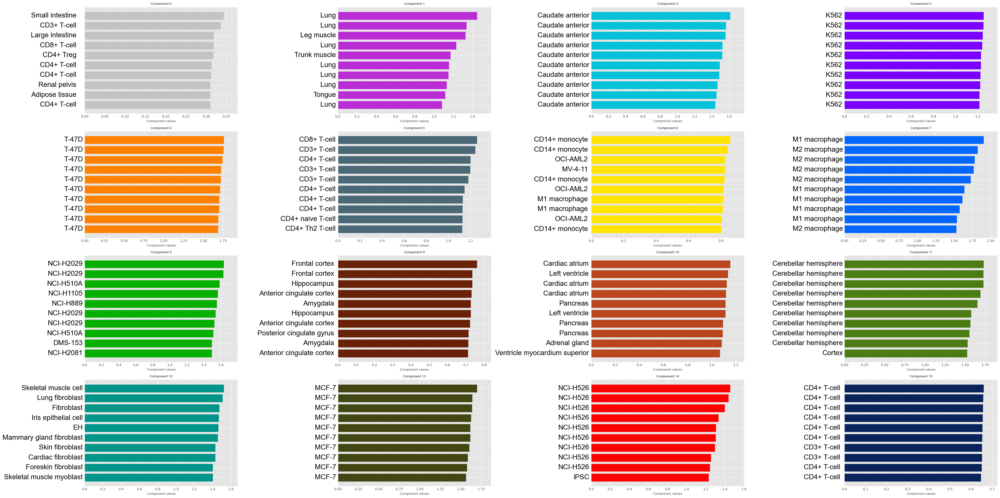

(4501, 18) (18, 1772171) matrixes loaded for n_components 18


/net/seq/data2/projects/aabisheva/Encode/my_ipynb/Vocabulary/OONMF.py:161: RuntimeWarning: invalid value encountered in divide
  self.NormedBasis =   (self.Basis.T / np.sum(self.Basis.T, axis=0)).T


Number of samples in this category  407
Number of samples in this category  123
Number of samples in this category  213
Number of samples in this category  185
Number of samples in this category  280
Number of samples in this category  121
Number of samples in this category  75
Number of samples in this category  133
Number of samples in this category  143
Number of samples in this category  619
Number of samples in this category  252
Number of samples in this category  293
Number of samples in this category  332
Number of samples in this category  686
Number of samples in this category  170
Number of samples in this category  182
Number of samples in this category  124
Number of samples in this category  163


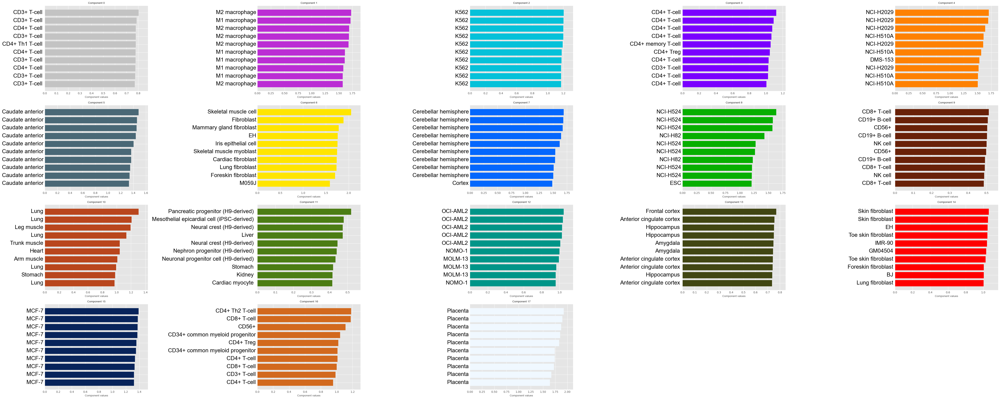

(4501, 20) (20, 1772171) matrixes loaded for n_components 20


/net/seq/data2/projects/aabisheva/Encode/my_ipynb/Vocabulary/OONMF.py:161: RuntimeWarning: invalid value encountered in divide
  self.NormedBasis =   (self.Basis.T / np.sum(self.Basis.T, axis=0)).T


Number of samples in this category  143
Number of samples in this category  196
Number of samples in this category  94
Number of samples in this category  209
Number of samples in this category  39
Number of samples in this category  76
Number of samples in this category  163
Number of samples in this category  38
Number of samples in this category  261
Number of samples in this category  719
Number of samples in this category  444
Number of samples in this category  59
Number of samples in this category  288
Number of samples in this category  284
Number of samples in this category  54
Number of samples in this category  108
Number of samples in this category  610
Number of samples in this category  218
Number of samples in this category  178
Number of samples in this category  320


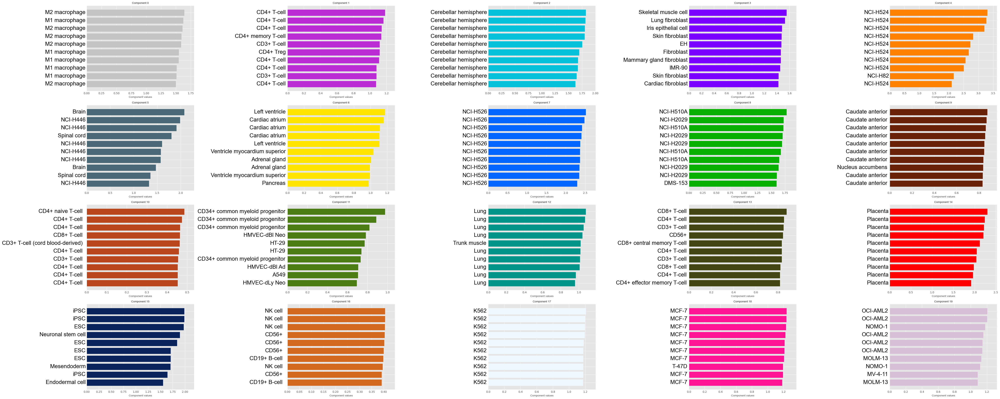

(4501, 22) (22, 1772171) matrixes loaded for n_components 22


/net/seq/data2/projects/aabisheva/Encode/my_ipynb/Vocabulary/OONMF.py:161: RuntimeWarning: invalid value encountered in divide
  self.NormedBasis =   (self.Basis.T / np.sum(self.Basis.T, axis=0)).T


Number of samples in this category  139
Number of samples in this category  111
Number of samples in this category  59
Number of samples in this category  178
Number of samples in this category  145
Number of samples in this category  149
Number of samples in this category  454
Number of samples in this category  226
Number of samples in this category  89
Number of samples in this category  189
Number of samples in this category  37
Number of samples in this category  235
Number of samples in this category  171
Number of samples in this category  50
Number of samples in this category  210
Number of samples in this category  412
Number of samples in this category  482
Number of samples in this category  191
Number of samples in this category  644
Number of samples in this category  119
Number of samples in this category  152
Number of samples in this category  59


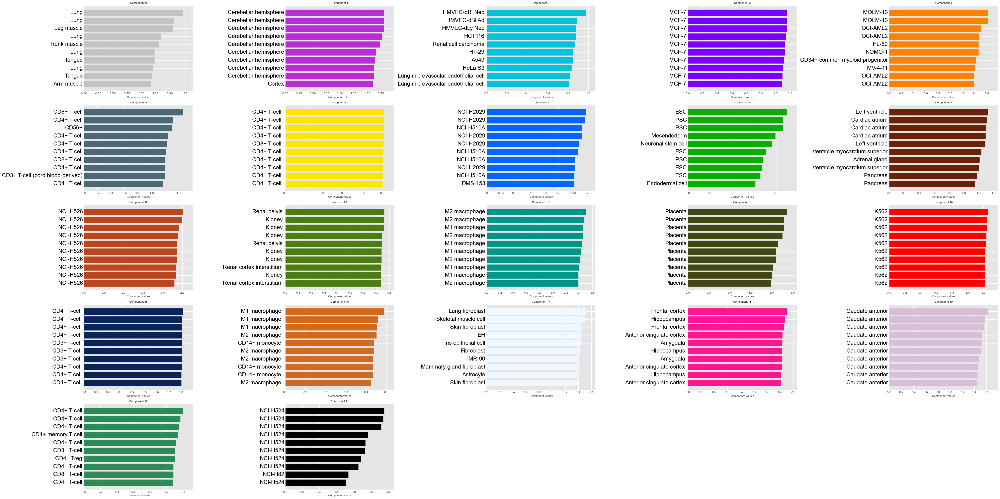

(4501, 24) (24, 1772171) matrixes loaded for n_components 24


/net/seq/data2/projects/aabisheva/Encode/my_ipynb/Vocabulary/OONMF.py:161: RuntimeWarning: invalid value encountered in divide
  self.NormedBasis =   (self.Basis.T / np.sum(self.Basis.T, axis=0)).T


Number of samples in this category  143
Number of samples in this category  81
Number of samples in this category  138
Number of samples in this category  109
Number of samples in this category  65
Number of samples in this category  100
Number of samples in this category  66
Number of samples in this category  39
Number of samples in this category  135
Number of samples in this category  277
Number of samples in this category  692
Number of samples in this category  133
Number of samples in this category  98
Number of samples in this category  85
Number of samples in this category  254
Number of samples in this category  47
Number of samples in this category  125
Number of samples in this category  88
Number of samples in this category  506
Number of samples in this category  116
Number of samples in this category  196
Number of samples in this category  212
Number of samples in this category  557
Number of samples in this category  239


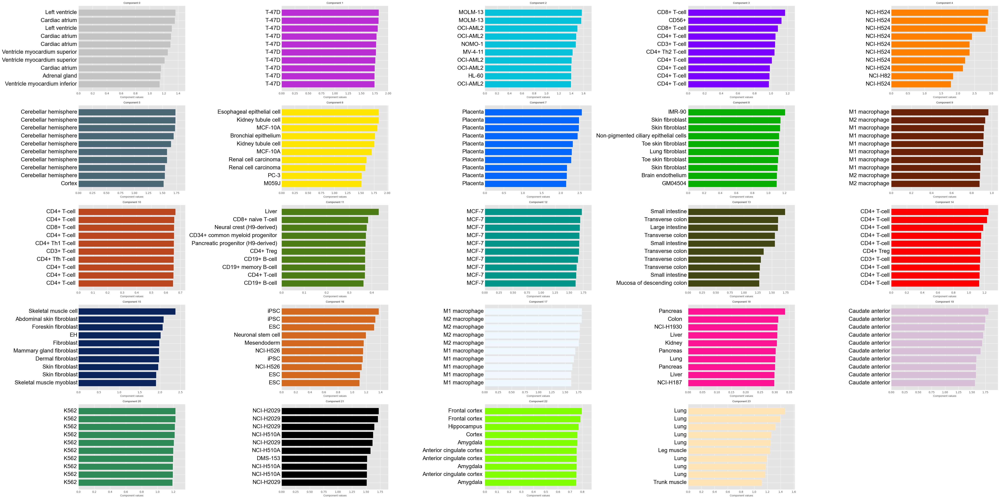

(4501, 26) (26, 1772171) matrixes loaded for n_components 26


/net/seq/data2/projects/aabisheva/Encode/my_ipynb/Vocabulary/OONMF.py:161: RuntimeWarning: invalid value encountered in divide
  self.NormedBasis =   (self.Basis.T / np.sum(self.Basis.T, axis=0)).T


Number of samples in this category  222
Number of samples in this category  115
Number of samples in this category  84
Number of samples in this category  561
Number of samples in this category  179
Number of samples in this category  674
Number of samples in this category  173
Number of samples in this category  39
Number of samples in this category  43
Number of samples in this category  268
Number of samples in this category  210
Number of samples in this category  88
Number of samples in this category  82
Number of samples in this category  123
Number of samples in this category  108
Number of samples in this category  89
Number of samples in this category  275
Number of samples in this category  304
Number of samples in this category  75
Number of samples in this category  103
Number of samples in this category  101
Number of samples in this category  80
Number of samples in this category  97
Number of samples in this category  74
Number of samples in this category  44
Number of s

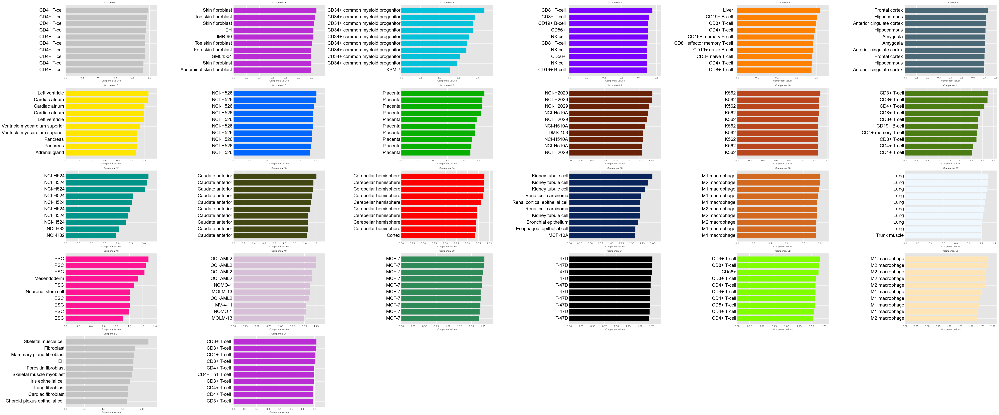

(4501, 28) (28, 1772171) matrixes loaded for n_components 28


/net/seq/data2/projects/aabisheva/Encode/my_ipynb/Vocabulary/OONMF.py:161: RuntimeWarning: invalid value encountered in divide
  self.NormedBasis =   (self.Basis.T / np.sum(self.Basis.T, axis=0)).T


Number of samples in this category  288
Number of samples in this category  68
Number of samples in this category  178
Number of samples in this category  65
Number of samples in this category  120
Number of samples in this category  595
Number of samples in this category  281
Number of samples in this category  116
Number of samples in this category  25
Number of samples in this category  205
Number of samples in this category  50
Number of samples in this category  146
Number of samples in this category  76
Number of samples in this category  558
Number of samples in this category  49
Number of samples in this category  73
Number of samples in this category  157
Number of samples in this category  106
Number of samples in this category  84
Number of samples in this category  137
Number of samples in this category  117
Number of samples in this category  67
Number of samples in this category  39
Number of samples in this category  38
Number of samples in this category  194
Number of s

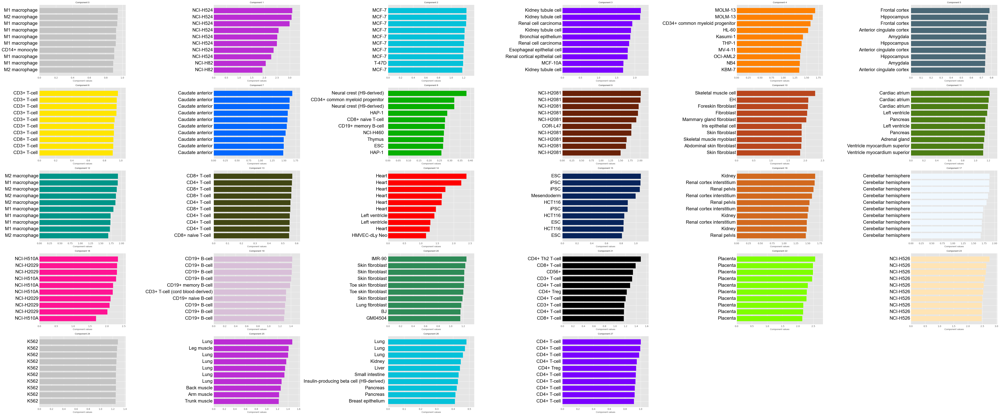

(4501, 30) (30, 1772171) matrixes loaded for n_components 30


/net/seq/data2/projects/aabisheva/Encode/my_ipynb/Vocabulary/OONMF.py:161: RuntimeWarning: invalid value encountered in divide
  self.NormedBasis =   (self.Basis.T / np.sum(self.Basis.T, axis=0)).T


Number of samples in this category  40
Number of samples in this category  90
Number of samples in this category  108
Number of samples in this category  94
Number of samples in this category  344
Number of samples in this category  106
Number of samples in this category  79
Number of samples in this category  101
Number of samples in this category  262
Number of samples in this category  147
Number of samples in this category  165
Number of samples in this category  173
Number of samples in this category  37
Number of samples in this category  182
Number of samples in this category  508
Number of samples in this category  534
Number of samples in this category  53
Number of samples in this category  73
Number of samples in this category  128
Number of samples in this category  166
Number of samples in this category  100
Number of samples in this category  131
Number of samples in this category  38
Number of samples in this category  57
Number of samples in this category  164
Number of

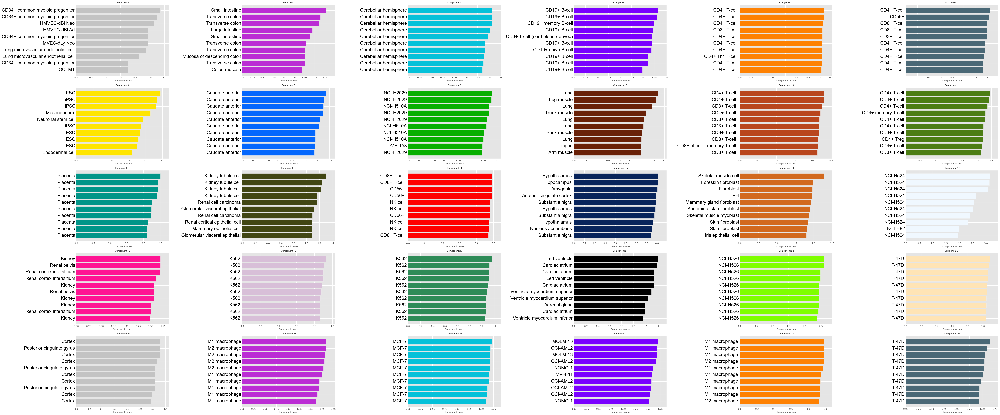

(4501, 32) (32, 1772171) matrixes loaded for n_components 32


/net/seq/data2/projects/aabisheva/Encode/my_ipynb/Vocabulary/OONMF.py:161: RuntimeWarning: invalid value encountered in divide
  self.NormedBasis =   (self.Basis.T / np.sum(self.Basis.T, axis=0)).T


Number of samples in this category  40
Number of samples in this category  219
Number of samples in this category  96
Number of samples in this category  351
Number of samples in this category  104
Number of samples in this category  80
Number of samples in this category  391
Number of samples in this category  59
Number of samples in this category  193
Number of samples in this category  188
Number of samples in this category  80
Number of samples in this category  210
Number of samples in this category  38
Number of samples in this category  53
Number of samples in this category  113
Number of samples in this category  138
Number of samples in this category  120
Number of samples in this category  91
Number of samples in this category  93
Number of samples in this category  24
Number of samples in this category  98
Number of samples in this category  54
Number of samples in this category  138
Number of samples in this category  54
Number of samples in this category  607
Number of sam

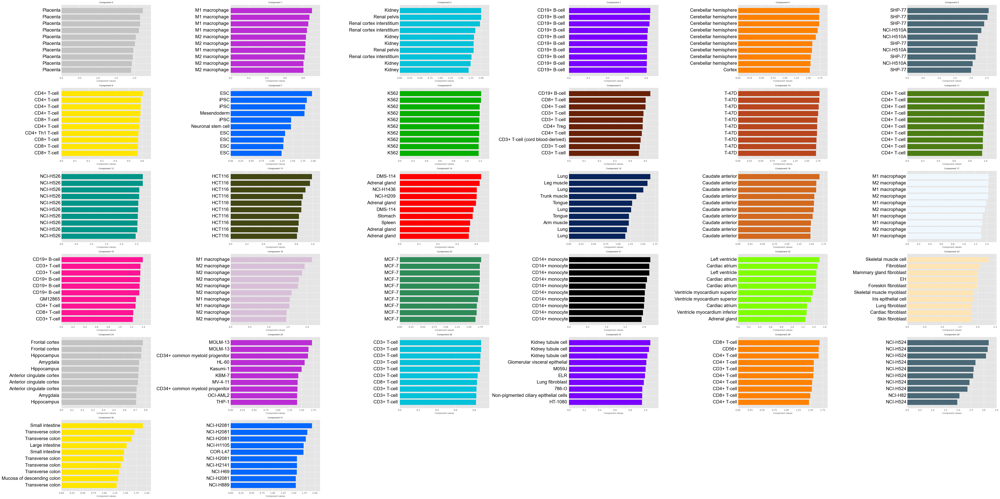

(4501, 34) (34, 1772171) matrixes loaded for n_components 34


/net/seq/data2/projects/aabisheva/Encode/my_ipynb/Vocabulary/OONMF.py:161: RuntimeWarning: invalid value encountered in divide
  self.NormedBasis =   (self.Basis.T / np.sum(self.Basis.T, axis=0)).T


Number of samples in this category  86
Number of samples in this category  34
Number of samples in this category  94
Number of samples in this category  60
Number of samples in this category  100
Number of samples in this category  46
Number of samples in this category  37
Number of samples in this category  290
Number of samples in this category  20
Number of samples in this category  552
Number of samples in this category  120
Number of samples in this category  34
Number of samples in this category  112
Number of samples in this category  256
Number of samples in this category  109
Number of samples in this category  62
Number of samples in this category  102
Number of samples in this category  84
Number of samples in this category  140
Number of samples in this category  147
Number of samples in this category  186
Number of samples in this category  50
Number of samples in this category  113
Number of samples in this category  71
Number of samples in this category  153
Number of sa

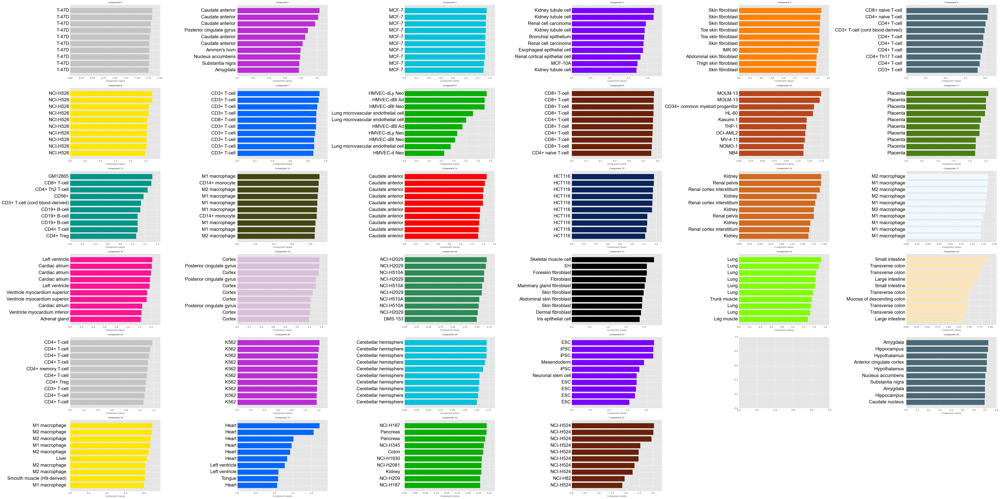

(4501, 36) (36, 1772171) matrixes loaded for n_components 36


/net/seq/data2/projects/aabisheva/Encode/my_ipynb/Vocabulary/OONMF.py:161: RuntimeWarning: invalid value encountered in divide
  self.NormedBasis =   (self.Basis.T / np.sum(self.Basis.T, axis=0)).T


Number of samples in this category  38
Number of samples in this category  113
Number of samples in this category  323
Number of samples in this category  74
Number of samples in this category  296
Number of samples in this category  140
Number of samples in this category  212
Number of samples in this category  104
Number of samples in this category  55
Number of samples in this category  36
Number of samples in this category  45
Number of samples in this category  77
Number of samples in this category  37
Number of samples in this category  553
Number of samples in this category  85
Number of samples in this category  34
Number of samples in this category  38
Number of samples in this category  136
Number of samples in this category  76
Number of samples in this category  51
Number of samples in this category  118
Number of samples in this category  57
Number of samples in this category  75
Number of samples in this category  98
Number of samples in this category  34
Number of sample

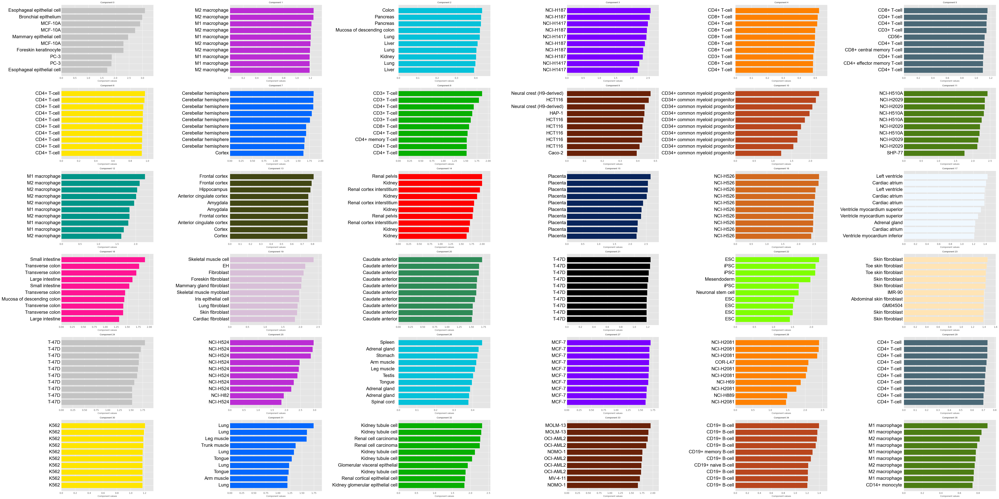

(4501, 38) (38, 1772171) matrixes loaded for n_components 38


/net/seq/data2/projects/aabisheva/Encode/my_ipynb/Vocabulary/OONMF.py:161: RuntimeWarning: invalid value encountered in divide
  self.NormedBasis =   (self.Basis.T / np.sum(self.Basis.T, axis=0)).T


Number of samples in this category  32
Number of samples in this category  37
Number of samples in this category  43
Number of samples in this category  46
Number of samples in this category  328
Number of samples in this category  371
Number of samples in this category  190
Number of samples in this category  141
Number of samples in this category  66
Number of samples in this category  75
Number of samples in this category  80
Number of samples in this category  115
Number of samples in this category  101
Number of samples in this category  42
Number of samples in this category  169
Number of samples in this category  96
Number of samples in this category  58
Number of samples in this category  104
Number of samples in this category  112
Number of samples in this category  66
Number of samples in this category  95
Number of samples in this category  60
Number of samples in this category  100
Number of samples in this category  36
Number of samples in this category  98
Number of sampl

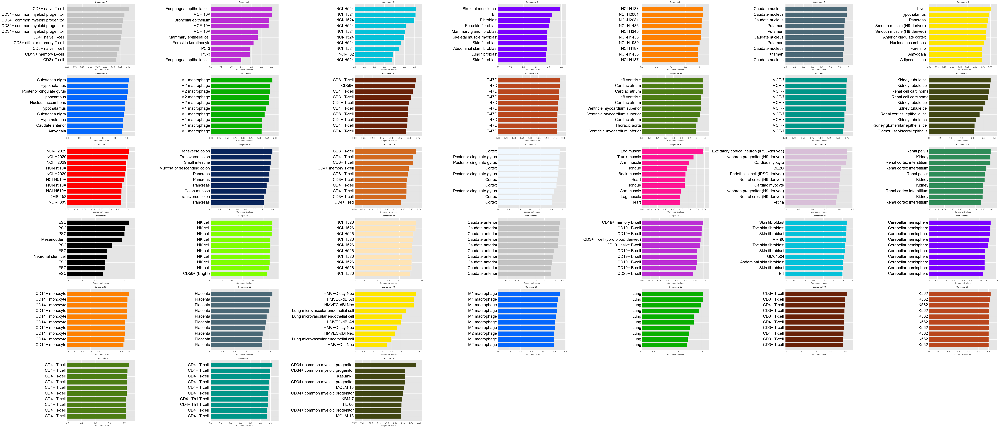

(4501, 40) (40, 1772171) matrixes loaded for n_components 40


/net/seq/data2/projects/aabisheva/Encode/my_ipynb/Vocabulary/OONMF.py:161: RuntimeWarning: invalid value encountered in divide
  self.NormedBasis =   (self.Basis.T / np.sum(self.Basis.T, axis=0)).T


Number of samples in this category  69
Number of samples in this category  92
Number of samples in this category  175
Number of samples in this category  45
Number of samples in this category  22
Number of samples in this category  175
Number of samples in this category  68
Number of samples in this category  385
Number of samples in this category  287
Number of samples in this category  78
Number of samples in this category  191
Number of samples in this category  88
Number of samples in this category  138
Number of samples in this category  80
Number of samples in this category  50
Number of samples in this category  92
Number of samples in this category  46
Number of samples in this category  278
Number of samples in this category  25
Number of samples in this category  79
Number of samples in this category  102
Number of samples in this category  70
Number of samples in this category  37
Number of samples in this category  70
Number of samples in this category  174
Number of sample

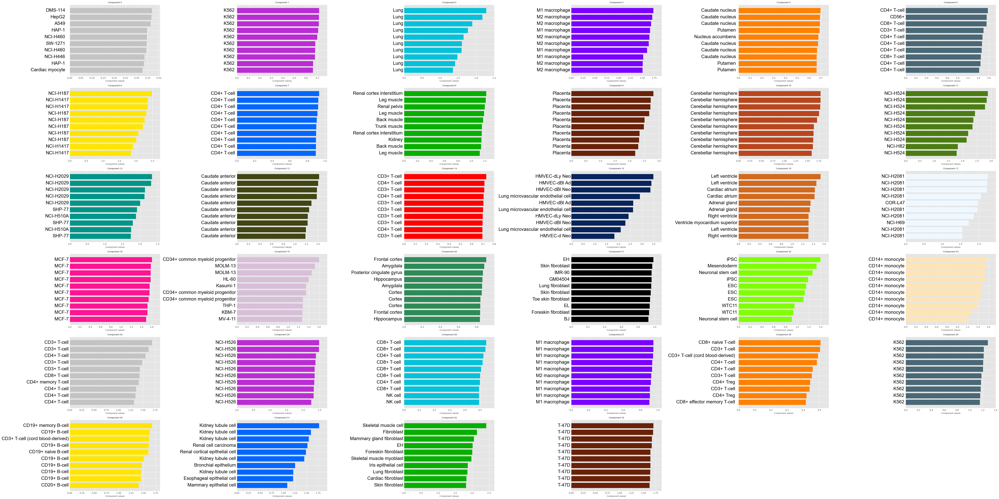

(3883, 36) (36, 1772171) matrixes loaded for n_components 36
Number of samples in this category  20
Number of samples in this category  102
Number of samples in this category  219
Number of samples in this category  78
Number of samples in this category  80
Number of samples in this category  78
Number of samples in this category  147
Number of samples in this category  180
Number of samples in this category  72
Number of samples in this category  60
Number of samples in this category  41
Number of samples in this category  167
Number of samples in this category  41
Number of samples in this category  34
Number of samples in this category  21
Number of samples in this category  95
Number of samples in this category  216
Number of samples in this category  36
Number of samples in this category  45
Number of samples in this category  99
Number of samples in this category  86
Number of samples in this category  40
Number of samples in this category  47
Number of samples in this category  

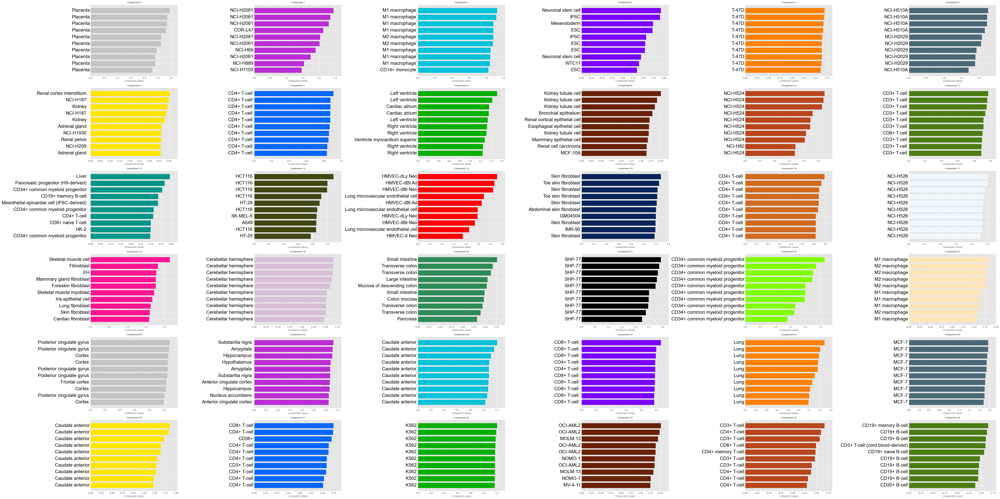

(3883, 38) (38, 1772171) matrixes loaded for n_components 38
Number of samples in this category  71
Number of samples in this category  46
Number of samples in this category  78
Number of samples in this category  103
Number of samples in this category  97
Number of samples in this category  75
Number of samples in this category  97
Number of samples in this category  36
Number of samples in this category  59
Number of samples in this category  241
Number of samples in this category  349
Number of samples in this category  248
Number of samples in this category  51
Number of samples in this category  89
Number of samples in this category  42
Number of samples in this category  80
Number of samples in this category  181
Number of samples in this category  21
Number of samples in this category  376
Number of samples in this category  73
Number of samples in this category  87
Number of samples in this category  67
Number of samples in this category  82
Number of samples in this category  

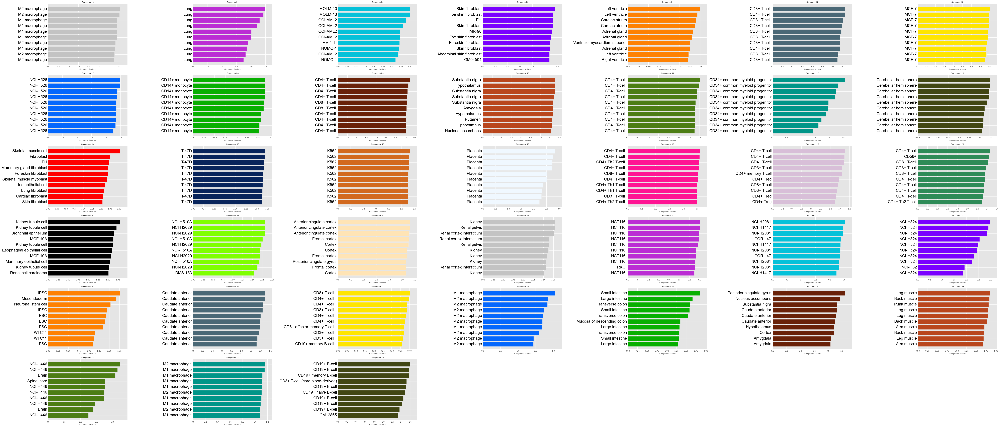

(3883, 40) (40, 1772171) matrixes loaded for n_components 40
Number of samples in this category  89
Number of samples in this category  72
Number of samples in this category  297
Number of samples in this category  133
Number of samples in this category  178
Number of samples in this category  40
Number of samples in this category  69
Number of samples in this category  130
Number of samples in this category  146
Number of samples in this category  27
Number of samples in this category  35
Number of samples in this category  130
Number of samples in this category  214
Number of samples in this category  20
Number of samples in this category  44
Number of samples in this category  80
Number of samples in this category  103
Number of samples in this category  100
Number of samples in this category  46
Number of samples in this category  74
Number of samples in this category  45
Number of samples in this category  43
Number of samples in this category  75
Number of samples in this categor

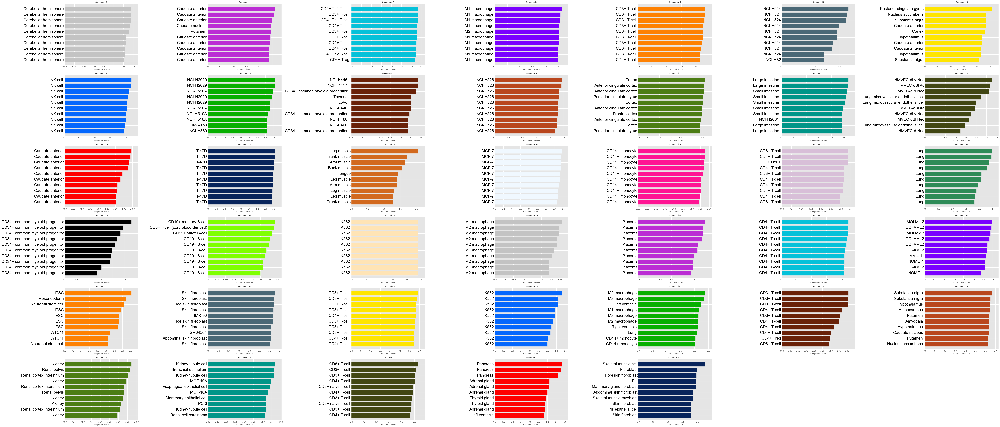

In [132]:
NC_ar = [16, 18, 20, 22, 24, 26, 28, 30, 32, 34, 36, 38, 40]
#NC_ar = [24]
prefix_range = ["bin_4501_index_not_downs_760_peaks", "bin_3883_index_not_downs_760_peaks"]

for prefix_set, base_matrix, allnames in zip(prefix_range, base_matrix_set, allnames_set):
    for n_components in NC_ar:
        
        prefix = prefix_set + '.'+ str(n_components)
        W_save_path = save_dir + prefix + ".W_new.npy"
        H_save_path = save_dir + prefix +".H_new.npy"
        
        decomp = OONMF.NMFobject(n_components)
        decomp.matrix_input_name(W_save_path, 
                                 H_save_path)
        decomp.read_matrix_input(compressed=False)
        print(decomp.Basis.shape, decomp.Mixture.shape, "matrixes loaded for n_components", n_components)
        
        decomp.normalize_matrices()
        bar_graph_sort_order = get_barsortorder(decomp.NormedBasis)
        decomp.define_colors()
        
        
        ### Iterpretation part, adjusted x axis
        plt.style.use('ggplot')
        # Determine the number of rows and columns for the subplots
        ncols = int(np.ceil(np.sqrt(n_components)))
        nrows = int(np.ceil(n_components / ncols))

        # Create a figure with subplots
        fig, axes = plt.subplots(nrows=nrows, ncols=ncols, figsize=(10 * ncols, 5 * nrows))
        axes = axes.flatten()  # Flatten the axes array to easily loop through

        for i_component in range(n_components):
            # Plot i_component major
            green_cut = np.argmax(decomp.Basis, axis=1) == i_component
            print("Number of samples in this category ", len(green_cut[green_cut]))

            if len(green_cut[green_cut]) >= 10: # if not, there are too few samples to count 10% top
                # Plot top 10% of this major as described:
                colors = decomp.Comp_colors
                decomp_Basis = decomp.Basis[green_cut] 

                # Get the top 10% of samples
                top_count = 10

                # Sort the samples by the value of the i_component
                sorted_indices = np.argsort(decomp_Basis[:, i_component])[-top_count:]
                sorted_matrix = decomp_Basis[sorted_indices, :]
                sorted_names = np.array(allnames)[green_cut][sorted_indices]

                # Create a horizontal stacked bar plot on the subplot
                ax = axes[i_component]
                ax.barh(np.arange(top_count), sorted_matrix[:, i_component], color=colors[i_component % len(colors)], label=f'Component {i_component}')

                # Adjust the x-axis range based on the data
                max_value = sorted_matrix[:, i_component].max()
                ax.set_xlim([0, max_value + 0.1 * max_value])  # set the x-axis limit to 110% of the max value

                ax.set_title(f'Component {i_component}', fontproperties=arial_font)

                # Add labels to the plot
                for i, name in enumerate(sorted_names):
                    # Position the text to the right of the bar
                    ax.text(-0.02, i, name, ha='right', va='center', color='black', fontsize=20, fontproperties=arial_font)

                # Customize the plot
                ax.set_yticks(np.arange(top_count))
                ax.set_yticklabels([])
                ax.set_xlabel('Component values', fontproperties=arial_font)

            else:
                continue

        # Remove unused subplots
        for i in range(i_component + 1, len(axes)):
            fig.delaxes(axes[i])

        # Adjust layout and show the figure
        fig.tight_layout()
        plt.savefig(dir_path_figures + prefix +'.reprojection.interpretation.10barplot.pdf', bbox_inches='tight')
        plt.show()

In [57]:
def swap_basis_mixture(self):
    self.Basis, self.Mixture = self.Mixture.T, self.Basis.T
    
OONMF.NMFobject.swap_basis_mixture = swap_basis_mixture

In [58]:
def filter_dhs(self, peaks_indices):
    self.Basis = self.Basis[peaks_indices, :]
    
OONMF.NMFobject.filter_dhs = filter_dhs

(4501, 24) (24, 1772171) matrixes loaded for n_components 24
(1772171, 24) (24, 4501) matrixes loaded for n_components 24
(50000, 24) (24, 4501) matrixes loaded for n_components 24


/net/seq/data2/projects/aabisheva/Encode/my_ipynb/Vocabulary/OONMF.py:160: RuntimeWarning: invalid value encountered in divide
  self.NormedMixture =   self.Mixture / np.sum(self.Mixture, axis=0)


<Figure size 640x480 with 0 Axes>

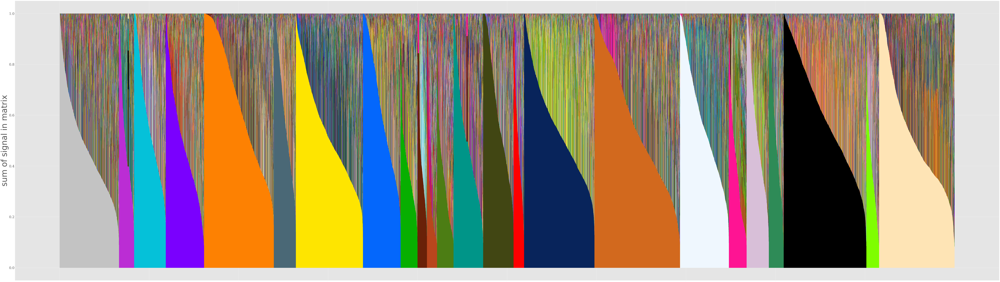

Time to plot:  2688.63453912735


In [140]:
NC_ar = [24]
prefix_range = ["bin_4501_index_not_downs_760_peaks"]#, "bin_3883_index_not_downs_760_peaks"]

for prefix_set, base_matrix, allnames in zip(prefix_range, base_matrix_set, allnames_set):
    for n_components in NC_ar:
        
        prefix = prefix_set + '.'+ str(n_components)
        W_save_path = save_dir + prefix + ".W_new.npy"
        H_save_path = save_dir + prefix +".H_new.npy"
        
        decomp = OONMF.NMFobject(n_components)
        decomp.matrix_input_name(W_save_path, 
                                 H_save_path)
        decomp.read_matrix_input(compressed=False)
        print(decomp.Basis.shape, decomp.Mixture.shape, "matrixes loaded for n_components", n_components)
        
        decomp.swap_basis_mixture()
        print(decomp.Basis.shape, decomp.Mixture.shape, "matrixes loaded for n_components", n_components)

        peaks_indices = np.random.choice(decomp.Basis.shape[0], 50000, replace=False)
        decomp.filter_dhs(peaks_indices)
        print(decomp.Basis.shape, decomp.Mixture.shape, "matrixes loaded for n_components", n_components)
        
        decomp.normalize_matrices()
        bar_graph_sort_order = get_barsortorder(decomp.Basis)
        decomp.define_colors()

        start_time = time.time()      
        bar_graph_sort_order = get_barsortorder(decomp.NormedBasis)

        # Normalized stacked barplot
        decomp.make_continuous_stacked_bar_plot_sorted(decomp.Basis.shape[0], 
                          decomp.NormedBasis.T, 
                          dir_path_figures + prefix + '.DHS_most_intensive_peaks_cut_'+str(decomp.Basis.shape[0])+'.stacked_bar_plot.normed.pdf', 
                          barsortorder=bar_graph_sort_order)
        print("Time to plot: ", time.time() - start_time)  

In [33]:
def plot_cumulative_distribution(data, label):
    # Identify the contribution of the major component for each DHS
    major_component_contributions = np.max(data, axis=1)
    
    # Compute the cumulative distribution
    hist, bin_edges = np.histogram(major_component_contributions, bins=np.linspace(0, 1, 100), density=True)
    cumulative_dhs = np.cumsum(hist[::-1])[::-1]
    
    # Plot the cumulative distribution
    plt.plot(bin_edges[:-1], cumulative_dhs, label=label)

In [45]:
def plot_cumulative_distribution(data, label):
    # Identify the contribution of the major component for each DHS
    major_component_contributions = np.max(data, axis=1)
    
    # Sort the data for ECDF
    sorted_contributions = np.sort(major_component_contributions)
    yvals = np.arange(1, len(sorted_contributions)+1) / float(len(sorted_contributions))
    
    # Plot the cumulative distribution
    plt.plot(sorted_contributions, yvals, label=label)


SET:  bin_4501_index_not_downs_760_peaks , N_components:  24
W:  (4501, 24)  H:  (24, 759464)  referense
W:  (4501, 24)  H:  (24, 1772171)  reprojected


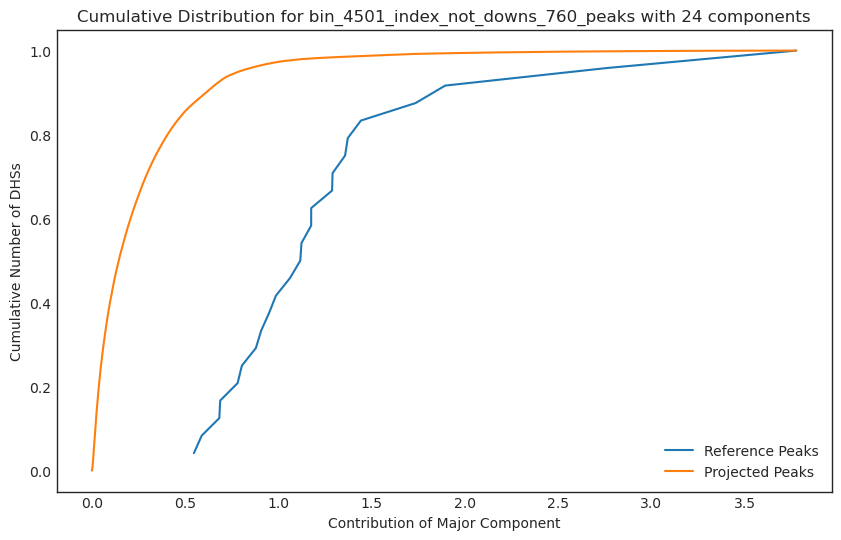

SET:  bin_3883_index_not_downs_760_peaks , N_components:  24
W:  (3883, 24)  H:  (24, 759464)  referense
W:  (3883, 24)  H:  (24, 1772171)  reprojected


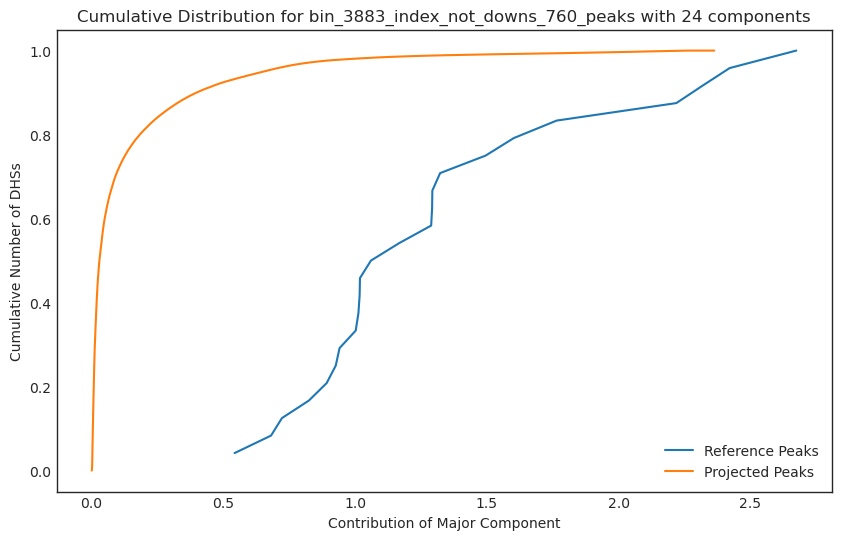

In [50]:
NC_ar = [24]
prefix_range = ["bin_4501_index_not_downs_760_peaks", "bin_3883_index_not_downs_760_peaks"]

for prefix_set, base_matrix, allnames in zip(prefix_range, base_matrix_set, allnames_set):
    for n_components in NC_ar:
        
        print("SET: ", prefix_set, ", N_components: ", n_components)

        prefix = prefix_set + '.' + str(n_components)

        W_path = dir_path_pipeline + prefix + '.W.npy'
        H_path = dir_path_pipeline + prefix + '.H.npy'

        W_matrix = np.load(W_path)
        H_matrix = np.load(H_path)

        print("W: ", W_matrix.shape, " H: ", H_matrix.shape, " referense")
        
        W_save_path = save_dir + prefix + ".W_new.npy"
        H_save_path = save_dir + prefix +".H_new.npy"
        
        W_new = np.load(W_save_path)
        H_new = np.load(H_save_path)
        
        print("W: ", W_new.shape, " H: ", H_new.shape, " reprojected")
        
        plt.figure(figsize=(10, 6))
        plot_cumulative_distribution(H_matrix, 'Reference Peaks')
        plot_cumulative_distribution(H_new.T, 'Projected Peaks')
        plt.xlabel('Contribution of Major Component')
        plt.ylabel('Cumulative Number of DHSs')
        plt.title(f'Cumulative Distribution for {prefix_set} with {n_components} components')
        plt.legend()
        plt.savefig(dir_path_figures + prefix + "_cumulative_distribution.png")
        plt.show()
    

In [77]:
def compute_cumulative_dhs(matrix):
    # Step 1: Sum each column (DHS)
    dhs_sums = np.sum(matrix, axis=0)
    
    # Step 2: For each column (DHS), compute the contribution of the major component.
    max_contributions = np.max(matrix, axis=0) / dhs_sums
    
    # Step 3: Sort these contributions in descending order.
    sorted_contributions = np.sort(max_contributions)[::-1]
    
    # Step 4: Create a cumulative count of DHSs.
    cumulative_counts = np.arange(1, len(sorted_contributions)+1)
    
    return sorted_contributions, cumulative_counts

SET:  bin_4501_index_not_downs_760_peaks , N_components:  24
W:  (4501, 24)  H:  (24, 759464)  referense
W:  (4501, 24)  H:  (24, 1772171)  reprojected


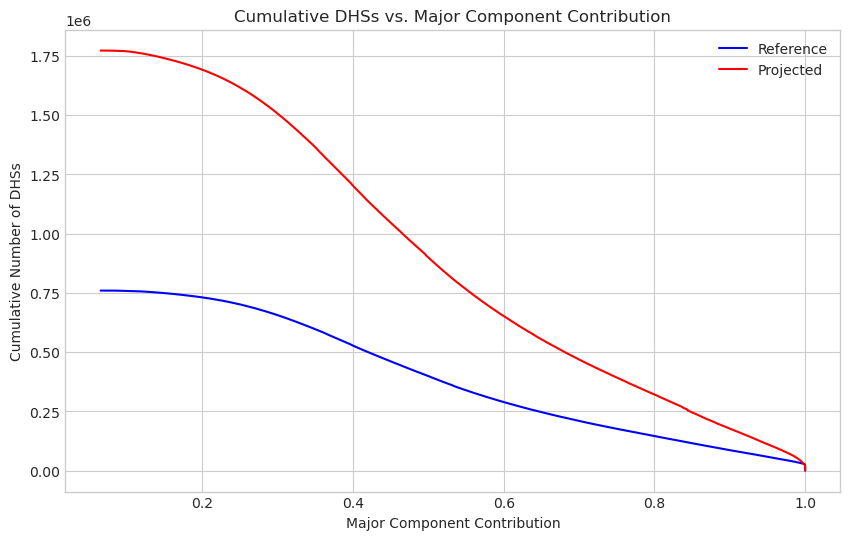

SET:  bin_3883_index_not_downs_760_peaks , N_components:  24
W:  (3883, 24)  H:  (24, 759464)  referense
W:  (3883, 24)  H:  (24, 1772171)  reprojected


/tmp/ipykernel_25301/2329585316.py:6: RuntimeWarning: invalid value encountered in divide
  max_contributions = np.max(matrix, axis=0) / dhs_sums


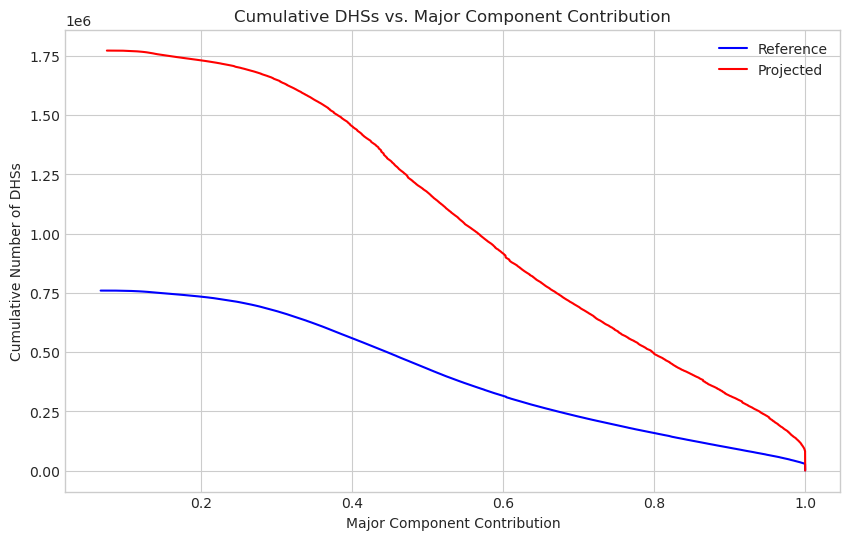

In [79]:
NC_ar = [24]
prefix_range = ["bin_4501_index_not_downs_760_peaks", "bin_3883_index_not_downs_760_peaks"]

for prefix_set, base_matrix, allnames in zip(prefix_range, base_matrix_set, allnames_set):
    for n_components in NC_ar:
        
        print("SET: ", prefix_set, ", N_components: ", n_components)

        prefix = prefix_set + '.' + str(n_components)

        W_path = dir_path_pipeline + prefix + '.W.npy'
        H_path = dir_path_pipeline + prefix + '.H.npy'

        W_matrix = np.load(W_path)
        H_matrix = np.load(H_path)

        print("W: ", W_matrix.shape, " H: ", H_matrix.shape, " referense")
        
        W_save_path = save_dir + prefix + ".W_new.npy"
        H_save_path = save_dir + prefix +".H_new.npy"
        
        W_new = np.load(W_save_path)
        H_new = np.load(H_save_path)
        
        print("W: ", W_new.shape, " H: ", H_new.shape, " reprojected")
        
        
        contributions_H, counts_H = compute_cumulative_dhs(H_matrix)
        contributions_H_new, counts_H_new = compute_cumulative_dhs(H_new)

        # Step 5: Plot the cumulative counts against the contributions.
        plt.figure(figsize=(10, 6))
        plt.plot(contributions_H, counts_H, label='Reference', color='blue')
        plt.plot(contributions_H_new, counts_H_new, label='Projected', color='red')
        plt.xlabel('Major Component Contribution')
        plt.ylabel('Cumulative Number of DHSs')
        plt.legend()
        plt.title('Cumulative DHSs vs. Major Component Contribution')
        plt.show()

SET:  bin_4501_index_not_downs_760_peaks , N_components:  24
W:  (4501, 24)  H:  (24, 759464)  referense
W:  (4501, 24)  H:  (24, 1772171)  reprojected


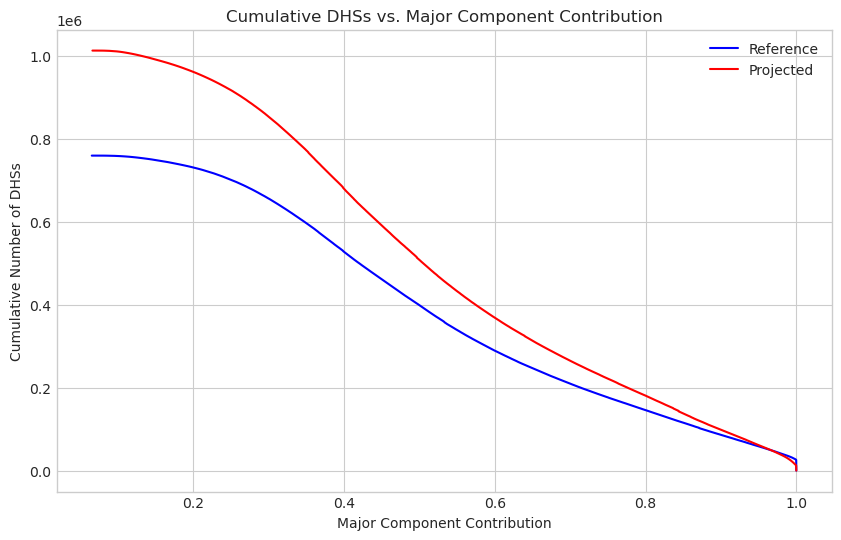

SET:  bin_3883_index_not_downs_760_peaks , N_components:  24
W:  (3883, 24)  H:  (24, 759464)  referense
W:  (3883, 24)  H:  (24, 1772171)  reprojected


/tmp/ipykernel_25301/2329585316.py:6: RuntimeWarning: invalid value encountered in divide
  max_contributions = np.max(matrix, axis=0) / dhs_sums


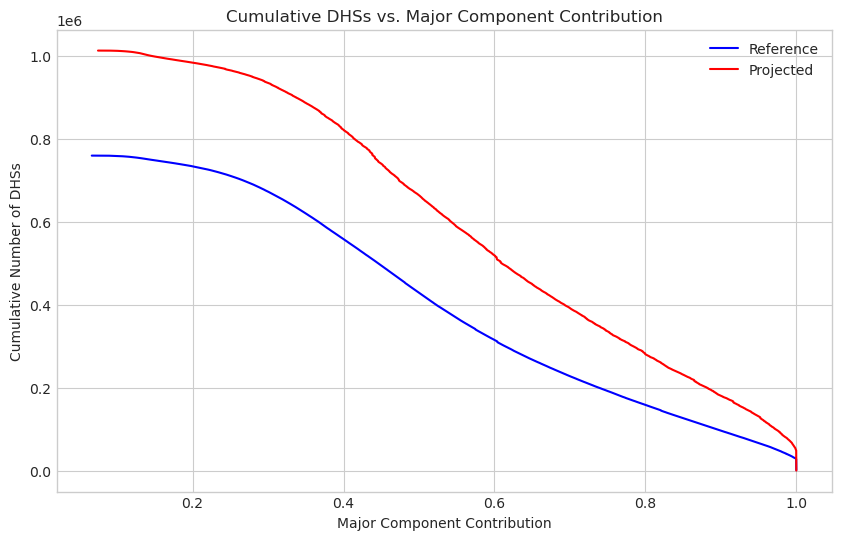

In [90]:
# cut 760k from 1.8M
inverted_mask = ~np.array(mask)

NC_ar = [24]
prefix_range = ["bin_4501_index_not_downs_760_peaks", "bin_3883_index_not_downs_760_peaks"]

for prefix_set, base_matrix, allnames in zip(prefix_range, base_matrix_set, allnames_set):
    for n_components in NC_ar:
        
        print("SET: ", prefix_set, ", N_components: ", n_components)

        prefix = prefix_set + '.' + str(n_components)

        W_path = dir_path_pipeline + prefix + '.W.npy'
        H_path = dir_path_pipeline + prefix + '.H.npy'

        W_matrix = np.load(W_path)
        H_matrix = np.load(H_path)

        print("W: ", W_matrix.shape, " H: ", H_matrix.shape, " referense")
        
        W_save_path = save_dir + prefix + ".W_new.npy"
        H_save_path = save_dir + prefix +".H_new.npy"
        
        W_new = np.load(W_save_path)
        H_new = np.load(H_save_path)
        
        print("W: ", W_new.shape, " H: ", H_new.shape, " reprojected")
        
        
        contributions_H, counts_H = compute_cumulative_dhs(H_matrix)
        contributions_H_new, counts_H_new = compute_cumulative_dhs(H_new[:, inverted_mask])

        # Step 5: Plot the cumulative counts against the contributions.
        plt.figure(figsize=(10, 6))
        plt.plot(contributions_H, counts_H, label='Reference', color='blue')
        plt.plot(contributions_H_new, counts_H_new, label='Projected', color='red')
        plt.xlabel('Major Component Contribution')
        plt.ylabel('Cumulative Number of DHSs')
        plt.legend()
        plt.title('Cumulative DHSs vs. Major Component Contribution')
        plt.show()

### Paired histograms

SET:  bin_4501_index_not_downs_760_peaks , N_components:  24
W:  (4501, 24)  H:  (24, 759464)  referense
W:  (4501, 24)  H:  (24, 1772171)  reprojected


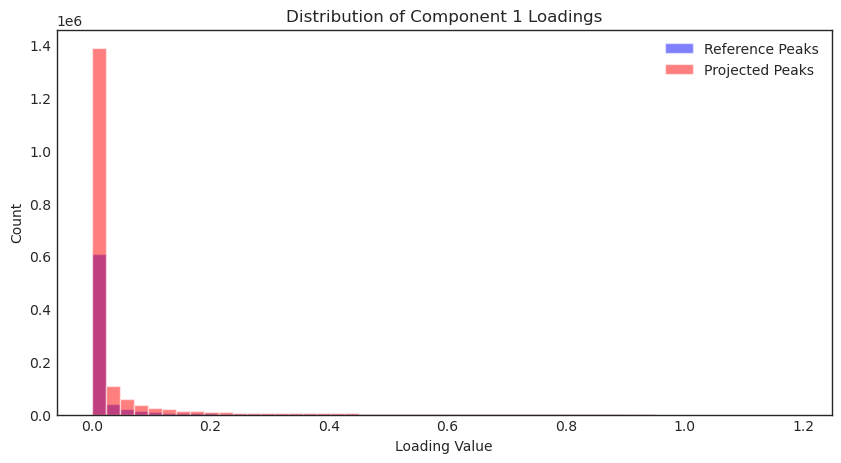

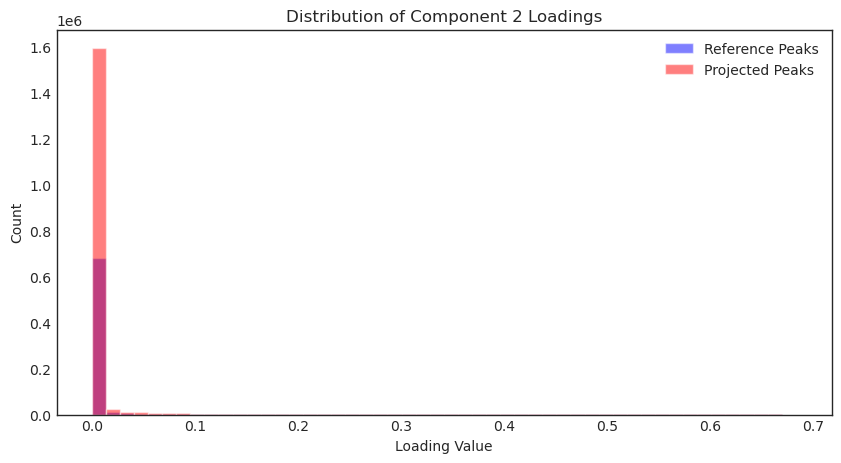

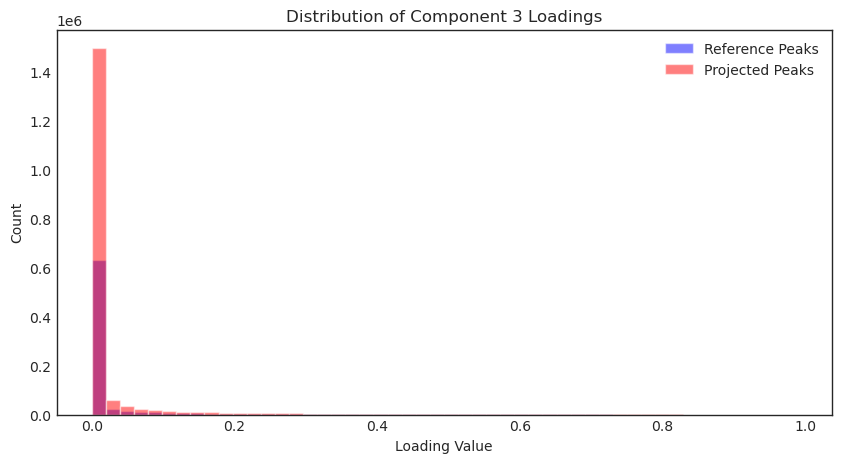

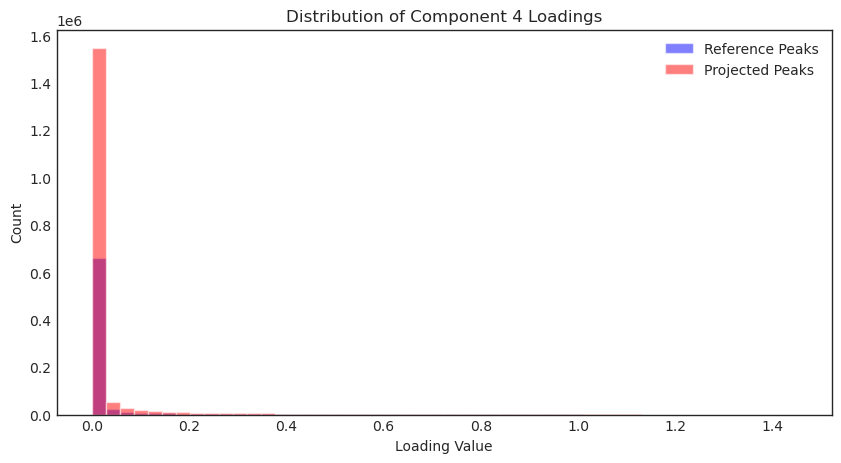

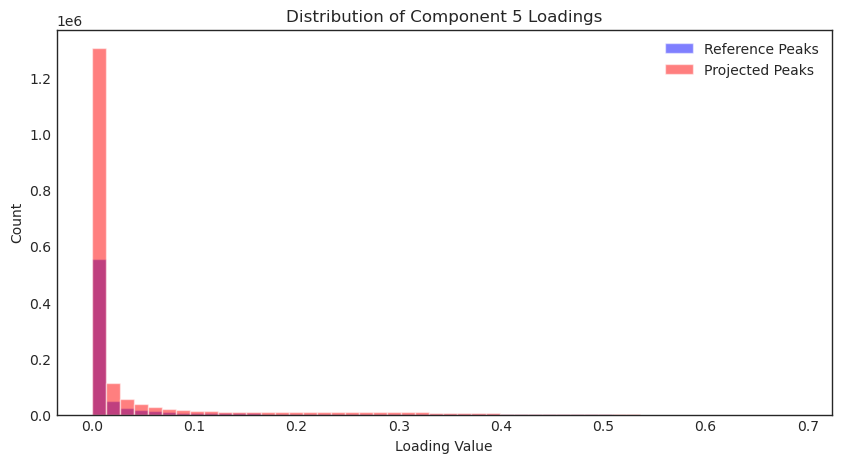

...

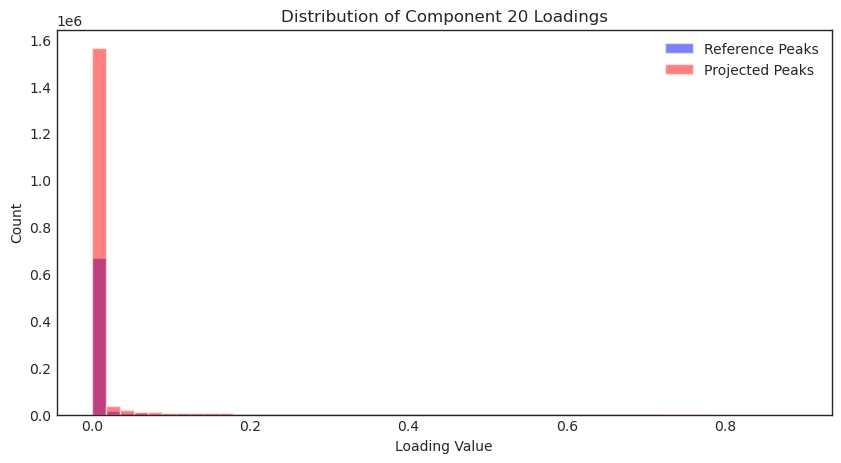

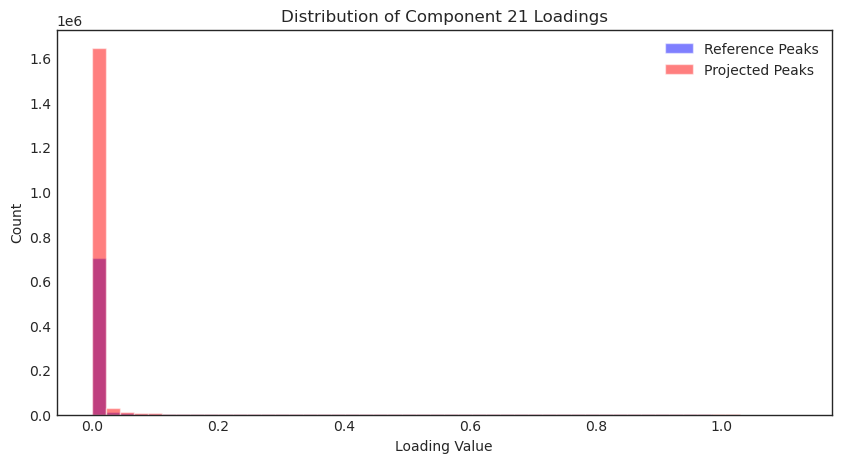

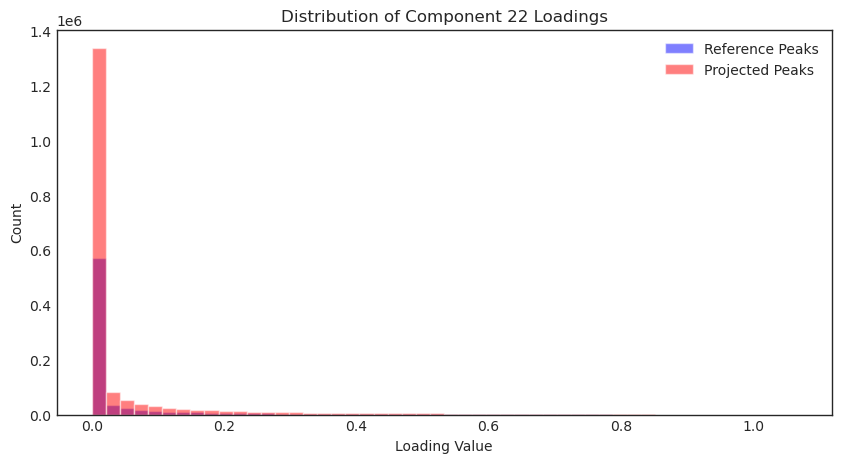

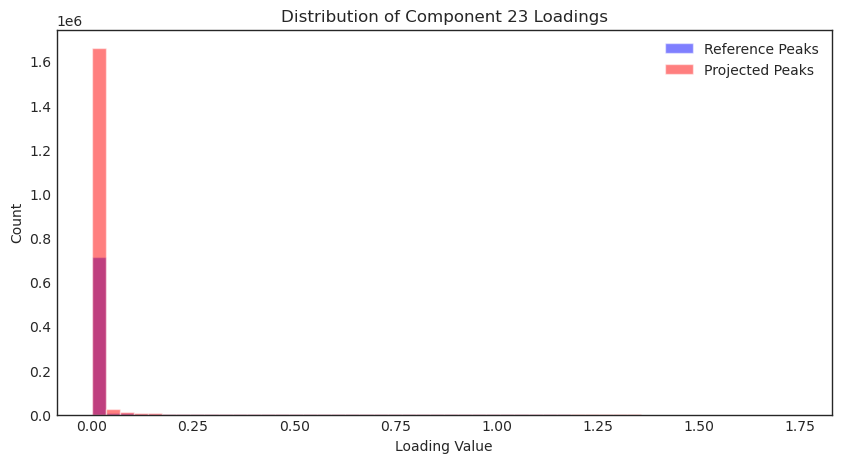

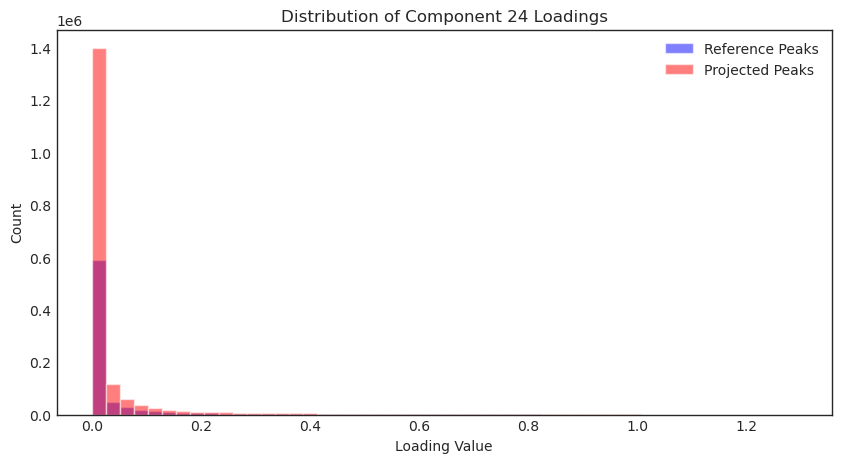

SET:  bin_3883_index_not_downs_760_peaks , N_components:  24
W:  (3883, 24)  H:  (24, 759464)  referense
W:  (3883, 24)  H:  (24, 1772171)  reprojected


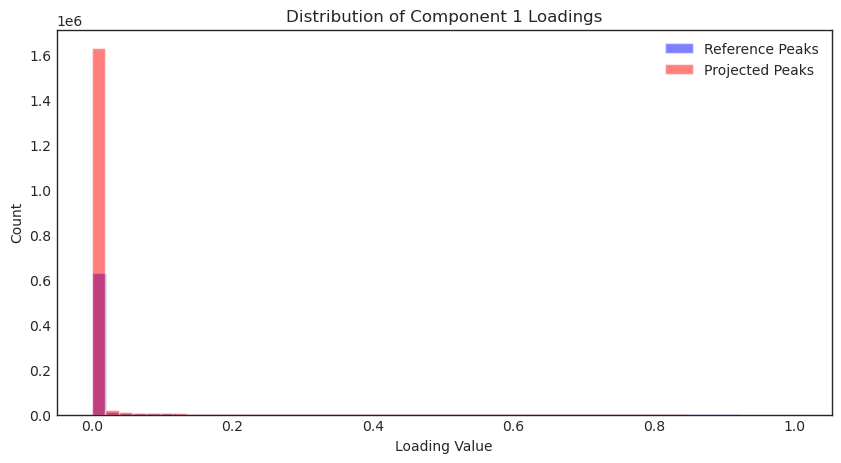

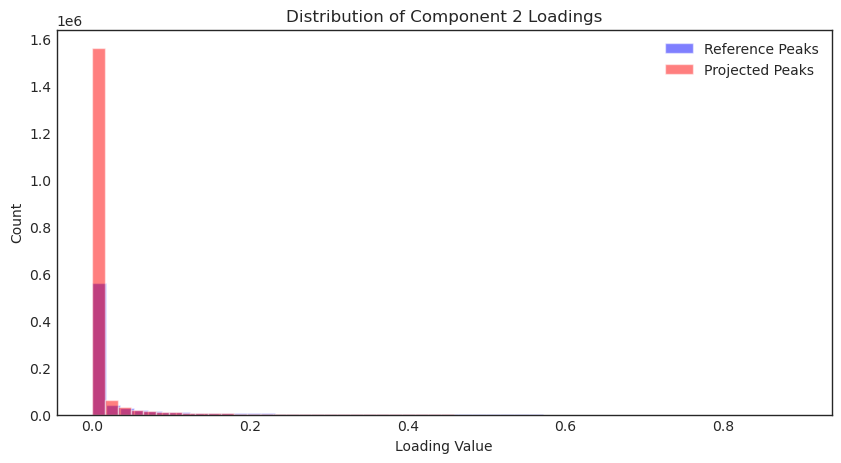

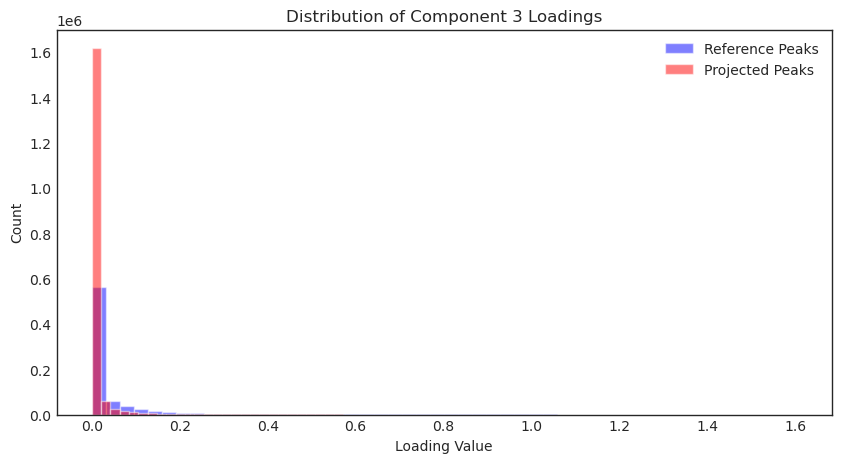

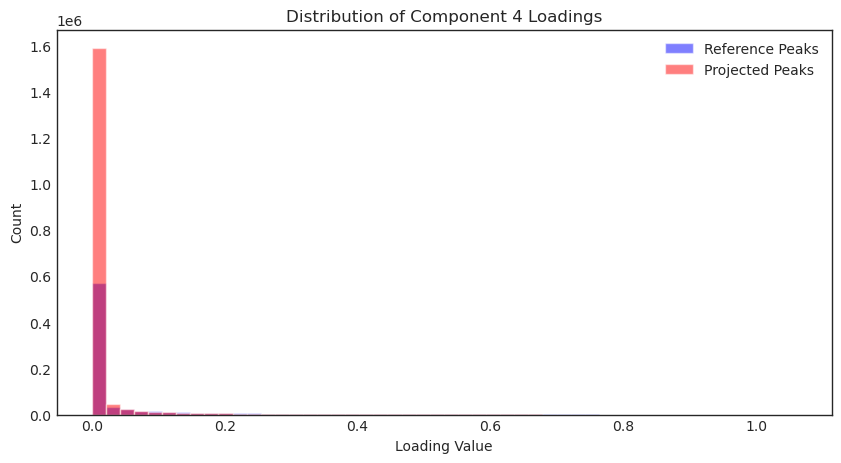

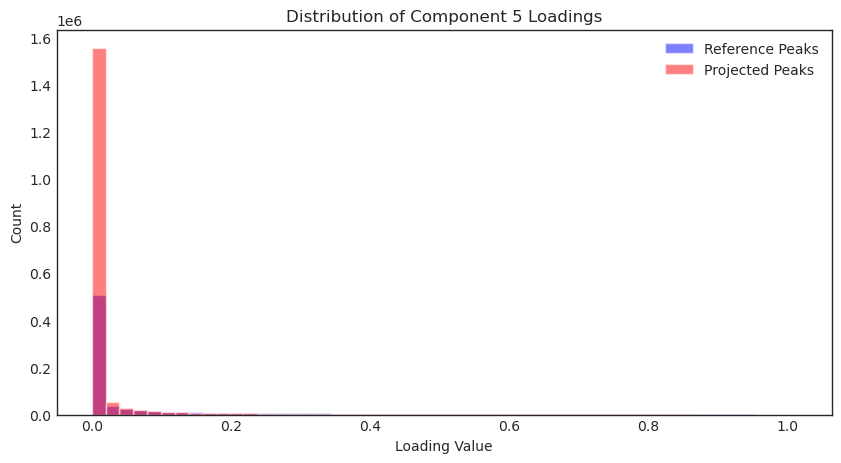

...

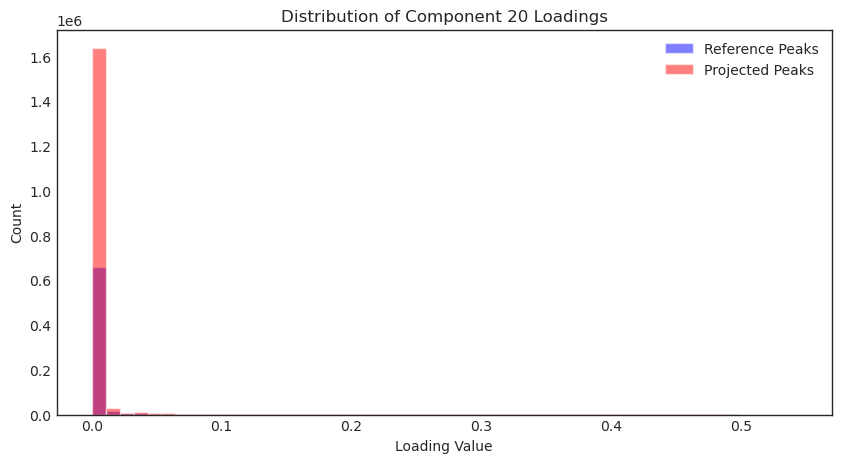

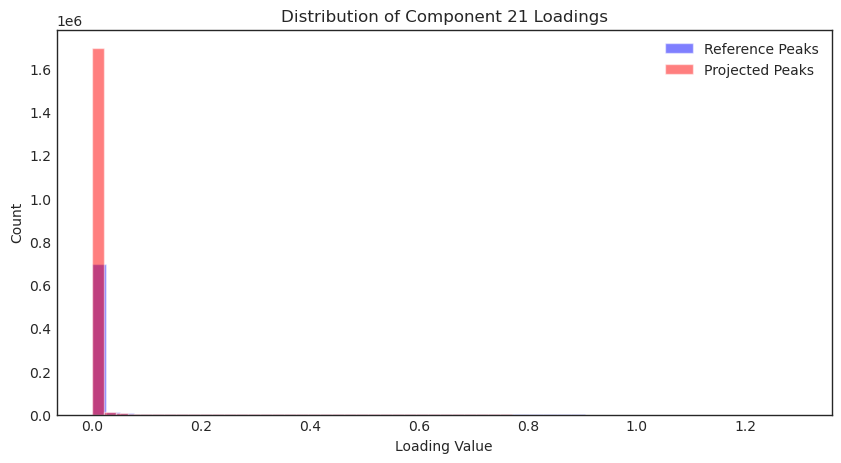

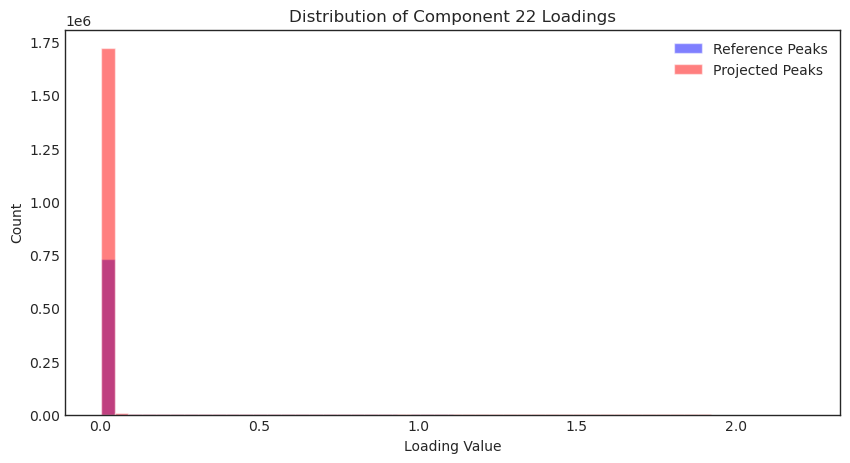

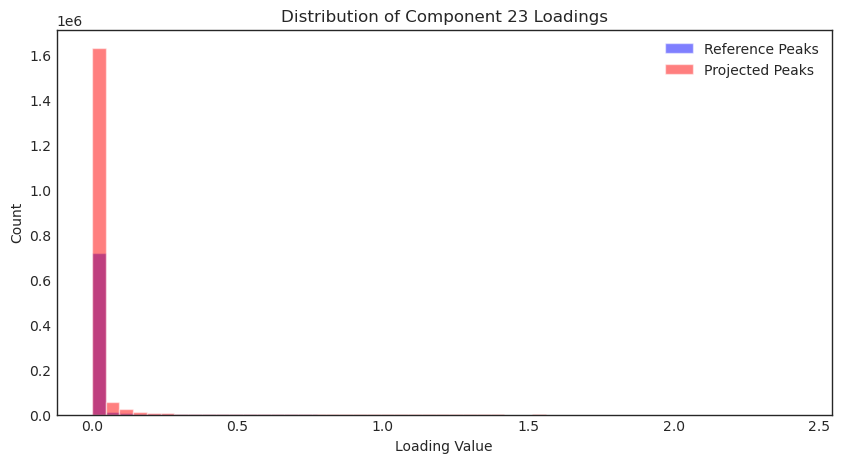

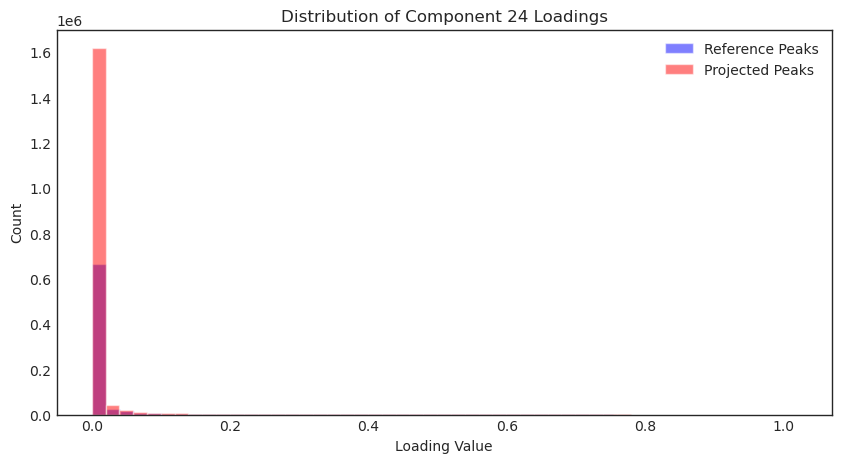

In [51]:
NC_ar = [24]
prefix_range = ["bin_4501_index_not_downs_760_peaks", "bin_3883_index_not_downs_760_peaks"]

for prefix_set, base_matrix, allnames in zip(prefix_range, base_matrix_set, allnames_set):
    for n_components in NC_ar:
        
        print("SET: ", prefix_set, ", N_components: ", n_components)

        prefix = prefix_set + '.' + str(n_components)

        W_path = dir_path_pipeline + prefix + '.W.npy'
        H_path = dir_path_pipeline + prefix + '.H.npy'

        W_matrix = np.load(W_path)
        H_matrix = np.load(H_path)

        print("W: ", W_matrix.shape, " H: ", H_matrix.shape, " referense")
        
        W_save_path = save_dir + prefix + ".W_new.npy"
        H_save_path = save_dir + prefix +".H_new.npy"
        
        W_new = np.load(W_save_path)
        H_new = np.load(H_save_path)
        
        print("W: ", W_new.shape, " H: ", H_new.shape, " reprojected")
        
        # Plotting paired histograms
        for component in range(n_components):
            plt.figure(figsize=(10, 5))
            plt.hist(H_matrix[component, :], bins=50, alpha=0.5, label="Reference Peaks", color='blue')
            plt.hist(H_new[component, :], bins=50, alpha=0.5, label="Projected Peaks", color='red')
            plt.title(f'Distribution of Component {component + 1} Loadings')
            plt.xlabel('Loading Value')
            plt.ylabel('Count')
            plt.legend()
            plt.savefig(dir_path_figures + prefix + f"_component_{component + 1}_histogram.png")
            plt.show()


In [67]:
def plot_component_loadings(decomp, arial_font, name_of_figure):
    """
    Plots the box plot of NMF Component Loadings.

    Parameters:
    - decomp: the NMF decomposition.
    - arial_font: the font properties for the labels.

    """
    decomp.define_colors()
    
    plt.style.use('seaborn-v0_8-whitegrid')
    n_components = decomp.Basis.shape[1]
    component_loadings = []
    comp_colors = decomp.Comp_colors

    for i_component in range(n_components):
        max_loaded = np.argmax(decomp.Basis, axis=1) == i_component
        #print(f"Number of samples for component {i_component}: {np.sum(max_loaded)}")
        component_loadings.append(decomp.Basis[max_loaded, i_component])

    # Reverse the order of component_loadings and comp_colors
    component_loadings = component_loadings[::-1]
    comp_colors = comp_colors[::-1]

    fig, ax = plt.subplots(figsize=(6, 10))
    bp = ax.boxplot(component_loadings, widths=0.5, whis=1.5, patch_artist=True, vert=False, medianprops=dict(color='black'))

    # Color the boxes
    for i, box in enumerate(bp['boxes']):
        box.set_facecolor(comp_colors[i])

    ax.set_yticklabels([f'{i}' for i in range(n_components-1, -1, -1)], fontproperties=arial_font)
    ax.set_xlabel('Loadings', fontproperties=arial_font)
    ax.set_ylabel('Component', fontproperties=arial_font)
    plt.title('Box plot of NMF Component Loadings', fontproperties=arial_font)
    plt.grid(True)

    for label in ax.get_xticklabels():
        label.set_fontproperties(arial_font)
    for label in ax.get_yticklabels():
        label.set_fontproperties(arial_font)

    plt.savefig(dir_path_figures + prefix + name_of_figure + ".pdf", bbox_inches='tight')
    plt.show()

In [75]:
def plot_dual_component_loadings(decomp1, decomp2, arial_font, name_of_figure):
    """
    Plots the box plot of NMF Component Loadings for two decomposition objects.

    Parameters:
    - decomp1, decomp2: the NMF decompositions.
    - arial_font: the font properties for the labels.
    - name_of_figure: name of the saved figure.

    """
    decomp1.define_colors()
    decomp2.define_colors()
    
    plt.style.use('seaborn-v0_8-whitegrid')
    
    # Assuming both decomp objects have the same number of components
    n_components = decomp1.Basis.shape[1]
    
    comp_colors1 = decomp1.Comp_colors
    comp_colors2 = decomp2.Comp_colors

    component_loadings1 = []
    component_loadings2 = []

    for i_component in range(n_components):
        max_loaded1 = np.argmax(decomp1.Basis, axis=1) == i_component
        max_loaded2 = np.argmax(decomp2.Basis, axis=1) == i_component
        
        component_loadings1.append(decomp1.Basis[max_loaded1, i_component])
        component_loadings2.append(decomp2.Basis[max_loaded2, i_component])

    # Reverse the order of component_loadings and comp_colors
    component_loadings1 = component_loadings1[::-1]
    component_loadings2 = component_loadings2[::-1]
    comp_colors1 = comp_colors1[::-1]
    comp_colors2 = comp_colors2[::-1]

    fig, ax = plt.subplots(figsize=(6, 10))
    
    flierprops = dict(marker='|', markerfacecolor='black', markersize=10, 
                  linestyle='-', linewidth=1.2, markeredgewidth=1.2)
    
    # Plotting two boxplots per component
    box_data = [val for pair in zip(component_loadings1, component_loadings2) for val in pair]
    bp = ax.boxplot(box_data, widths=0.5, whis=1.5, patch_artist=True, vert=False, medianprops=dict(color='black'), flierprops=flierprops)

    # Color the boxes
    for i, box in enumerate(bp['boxes']):
        if i % 2 == 0:
            box.set_facecolor(comp_colors1[i//2])
        else:
            box.set_facecolor(comp_colors2[i//2])

    # Create yticklabels
    yticklabels = [f"{i+1}_{suffix}" for i in range(n_components) for suffix in ['ref', 'new']]
    ax.set_yticklabels(yticklabels, fontproperties=arial_font)
    ax.set_xlabel('Loadings', fontproperties=arial_font)
    ax.set_ylabel('Component', fontproperties=arial_font)
    plt.title('Box plot of Dual NMF Component Loadings', fontproperties=arial_font)
    plt.grid(True)

    for label in ax.get_xticklabels():
        label.set_fontproperties(arial_font)
    for label in ax.get_yticklabels():
        label.set_fontproperties(arial_font)

    plt.savefig(dir_path_figures + prefix + name_of_figure + ".pdf", bbox_inches='tight')
    plt.show()


In [92]:
def filter_dhs(self, peaks_indices):
    self.Basis = self.Basis[peaks_indices, :]
    
OONMF.NMFobject.filter_dhs = filter_dhs

SET:  bin_4501_index_not_downs_760_peaks , N_components:  24
(4501, 24) (24, 759464) matrixes loaded for n_components 24
(759464, 24) (24, 4501) matrixes loaded for n_components 24
(4501, 24) (24, 1772171) matrixes loaded for n_components 24
(1772171, 24) (24, 4501) matrixes loaded for n_components 24
(1012707, 24) (24, 4501) matrixes loaded for n_components 24


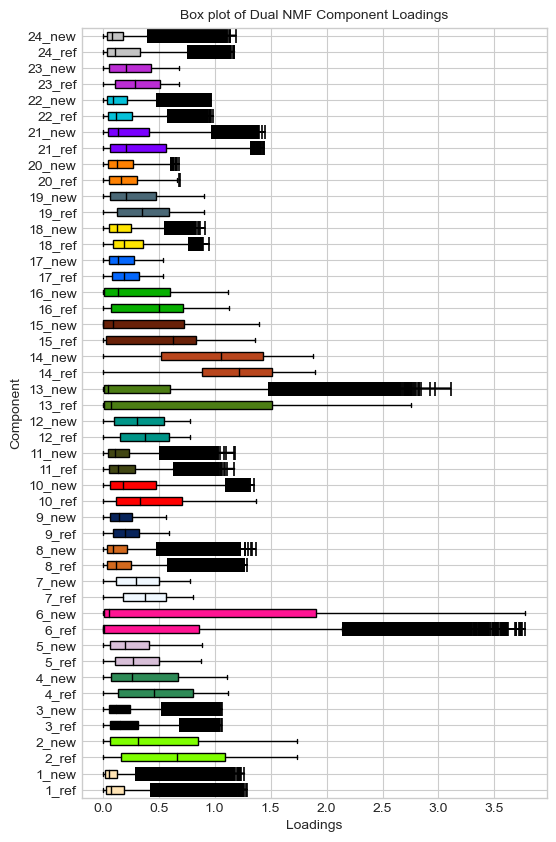

SET:  bin_3883_index_not_downs_760_peaks , N_components:  24
(3883, 24) (24, 759464) matrixes loaded for n_components 24
(759464, 24) (24, 3883) matrixes loaded for n_components 24
(3883, 24) (24, 1772171) matrixes loaded for n_components 24
(1772171, 24) (24, 3883) matrixes loaded for n_components 24
(1012707, 24) (24, 3883) matrixes loaded for n_components 24


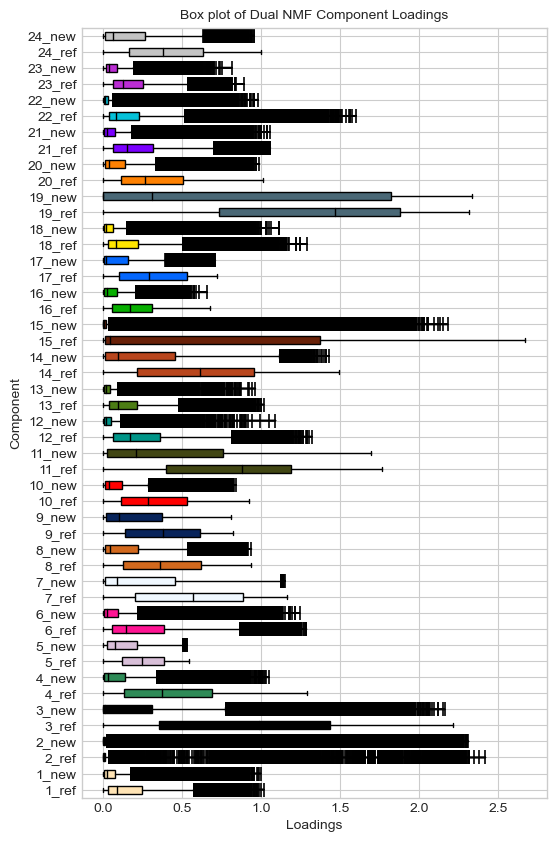

In [94]:
NC_ar = [24]
prefix_range = ["bin_4501_index_not_downs_760_peaks", "bin_3883_index_not_downs_760_peaks"]

for prefix_set, base_matrix, allnames in zip(prefix_range, base_matrix_set, allnames_set):
    for n_components in NC_ar:
        
        print("SET: ", prefix_set, ", N_components: ", n_components)

        prefix = prefix_set + '.' + str(n_components)

        W_path = dir_path_pipeline + prefix + '.W.npy'
        H_path = dir_path_pipeline + prefix + '.H.npy'

        decomp_ref = OONMF.NMFobject(n_components)
        decomp_ref.matrix_input_name(W_path, 
                                 H_path)
        decomp_ref.read_matrix_input(compressed=False)
        print(decomp_ref.Basis.shape, decomp_ref.Mixture.shape, "matrixes loaded for n_components", n_components)
        
        decomp_ref.swap_basis_mixture()
        print(decomp_ref.Basis.shape, decomp_ref.Mixture.shape, "matrixes loaded for n_components", n_components)
        
        W_save_path = save_dir + prefix + ".W_new.npy"
        H_save_path = save_dir + prefix +".H_new.npy"
        
        decomp_new = OONMF.NMFobject(n_components)
        decomp_new.matrix_input_name(W_save_path, 
                                 H_save_path)
        decomp_new.read_matrix_input(compressed=False)
        print(decomp_new.Basis.shape, decomp_new.Mixture.shape, "matrixes loaded for n_components", n_components)
        
        decomp_new.swap_basis_mixture()
        print(decomp_new.Basis.shape, decomp_new.Mixture.shape, "matrixes loaded for n_components", n_components)
        
        decomp_new.filter_dhs(inverted_mask)
        print(decomp_new.Basis.shape, decomp_new.Mixture.shape, "matrixes loaded for n_components", n_components)
        
        #plot_component_loadings(decomp_ref, arial_font, "box_plot_dhs_components_ref")
        plot_dual_component_loadings(decomp_ref, decomp_new, arial_font, "box_plot_dhs_components_ref")

  

# All the same, but downsampled

## again, cutting

In [14]:
full_bin_downsamled =  np.load('/net/seq/data2/projects/sabramov/SuperIndex/dnase_peak_density_analysis/downsample/downsampled_matrices.0912/overlapping.downsampled/output/binary.only_autosomes.filtered.matrix.npy')
full_bin_downsamled.shape

(4624859, 4501)

In [46]:
# Cut 760k informative peaks:
mask_path_760_out_of_18M = "/net/seq/data2/projects/sabramov/SuperIndex/clean_index_clustering/dnase_3883/output/models_results/cf0.15@ms1.0@mv0.7@add0@signal@nc32/cf0.15@ms1.0@mv0.7@add0@signal@nc32.selected_peaks.mask.txt"
with open(mask_path_760_out_of_18M, 'r') as f:
    mask = [bool(float(line.strip())) for line in f]

In [48]:
# Load the smaller BED file
small_bed_path = "/net/seq/data2/projects/sabramov/SuperIndex/clean_index_clustering/dnase_3883/output/masterlist.vp_annotated.sorted.bed"
small_bed_df = pd.read_table(small_bed_path, header=0) 

# Load the larger BED file
large_bed_path = "/net/seq/data2/projects/ENCODE4Plus/indexes/index_altius_23-09-12/output/masterlist.only_autosomes.filtered.bed"
large_bed_df = pd.read_table(large_bed_path, header=None, names=small_bed_df.columns)

selected_small_bed_df = small_bed_df[mask]
merged_df = pd.merge(large_bed_df, selected_small_bed_df, on=["V4"], how="left", indicator=True)
large_mask = merged_df['_merge'] == 'both'
full_bin_downsamled_760_peaks = full_bin_downsamled[large_mask]
save_path = "/net/seq/data2/projects/aabisheva/Encode/input_matrixes/filtered.full_bin_downsamled_760_peaks.npy"
np.save(save_path, full_bin_downsamled_760_peaks)

In [ ]:
# load cells from the top!
# Then:

In [52]:
filtered_matrix_downsamled = full_bin_downsamled[:, matching_indices]
save_path = "/net/seq/data2/projects/aabisheva/Encode/input_matrixes/filtered.3883_bin_downsamled_all_peaks.npy"
np.save(save_path, filtered_matrix_downsamled)

In [53]:
filtred_downsamled_760k_peaks = filtered_matrix_downsamled[large_mask]
save_path = "/net/seq/data2/projects/aabisheva/Encode/input_matrixes/filtered.3883_bin_downsamled_760k_peaks.npy"
np.save(save_path, filtred_downsamled_760k_peaks)

key_columns = ["V4"]
merged_df = pd.merge(large_bed_df, small_bed_df[key_columns], on=key_columns, how="left", indicator=True)
mask = merged_df['_merge'] == 'both'
filtered_full_bin_downsamled = full_bin_downsamled[mask.values]
save_path = "/net/seq/data2/projects/aabisheva/Encode/input_matrixes/filtered.4501_bin_downsamled_18M_peaks.npy"
np.save(save_path, filtered_full_bin_downsamled)

# calculating nmf reprojections